In [1]:
import SIMSIToolBox
import matplotlib.pyplot as plt
import os
import pandas as pd
import numpy as np
from matplotlib.colors import ListedColormap, LinearSegmentedColormap
from copy import deepcopy
from sklearn.cluster import KMeans
import pickle as pkl
import molmass
import SIMSIToolBox.recalibration
import importlib
importlib.reload(SIMSIToolBox)
import seaborn as sb

In [2]:
datadir = "X:/MSI_Shared_Data/13CImagingManuscript/raw_data/non-perfused/maldi/13C/"
subdirs = ["12x","14x"]

In [3]:
peaklist = pd.read_csv(datadir + "../metabolites_with_signal_to_extract_annotated.csv")
peaklist

,ion,formula,adduct,mz,name,labeling trend,pool size trend in tumor,14x,12x,10x,8x,100um,50um,comment,moleculeNames,moleculeIds,for_paper
0,C10H14N5O7P-H-,C10H14N5O7P,M-H,346.055729,AMP,1,1,0,1,0,0,1,1,NaN,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",1
1,C10H17N3O6S-H-,C10H17N3O6S,M-H,306.076451,Glutathione,1,1,1,1,0,0,1,1,NaN,Glutathione,HMDB0000125,0
2,C10H9N-H-,C10H9N,M-H,142.066144,6-Methylquinoline,0,0,1,1,0,0,0,1,NaN,"6-Methylquinoline, 2-Aminonaphthalene, Quinaldine","HMDB0033115, HMDB0041802, HMDB0042004",0
3,C12H14N2-H-,C12H14N2,M-H,185.108343,Detomidine,0,0,0,1,0,0,1,1,NaN,"1,2,3,4-Tetrahydro-2-methyl-b-carboline, 1-Phe...","HMDB0029836, HMDB0037144, HMDB0041872",0
4,C16H32O2-H-,C16H32O2,M-H,255.232875,Palmitate,1,1,0,1,0,0,1,1,some interference at 14x 50 um,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",1
5,C18H36O2-H-,C18H36O2,M-H,283.264176,Stearate,1,1,0,1,0,0,0,1,NaN,"Stearic acid, Ethyl hexadecanoate, 16-Methylhe...","HMDB0000827, HMDB0029811, HMDB0031066, HMDB006...",1
6,C20H32O2-H-,C20H32O2,M-H,303.232875,Arachidonate,1,1,0,1,0,0,1,1,NaN,"ent-17-Hydroxy-16beta-kauran-19-al, Arachidoni...","HMDB0036721, HMDB0001043, HMDB0002177, HMDB000...",0
7,C2H7NO3S-H-,C2H7NO3S,M-H,124.007309,Taurine,0,0,1,1,1,0,1,1,NaN,Taurine,HMDB0000251,0
8,C3H7O7P-H-,C3H7O7P,M-H,184.985584,2PG,0,0,1,0,0,0,1,0,NaN,"2-Phosphoglyceric acid, 3-Phosphoglyceric acid...","HMDB0000362, HMDB0000807, HMDB0003391, HMDB006...",0
9,C4H12NO4P-H-,C4H12NO4P,M-H,168.043039,Phosphodimethylethanolamine,0,0,1,1,1,1,1,1,NaN,Phosphodimethylethanolamine,HMDB0060244,0


In [4]:
ppmThresh = 5
num_cores = 20
intensityCutoff = 100
convSquare = 3 #size of filter (1=1x1,3=3x3,5=5x5)
colormap = LinearSegmentedColormap.from_list("test",colors=["black", "navy","blue","cyan","yellow","orange","orangered","red","mistyrose","white"],N=256)
dm_method = "PCA" #method for dimensionality reduction ("PCA" or "TSNE") PCA has worked better for me
seg_method = "K_means" #thresholding method ("TIC_auto", "K_means", "TIC_manual")
num_components = 2 #number of compoents to use with PCA or TSNE
filtMethod = "GB" #filtering method (GB = gaussian blur, MA = moving average)

c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\pyimzml\ontology\ontology.py:94: UserWarning: Accession IMS:1000046 found with incorrect name "pixel size x". Updating name to "pixel size (x)".
  % (accession, raw_name, name)


300 peaks found
12 hits found
12 peaks in roi found


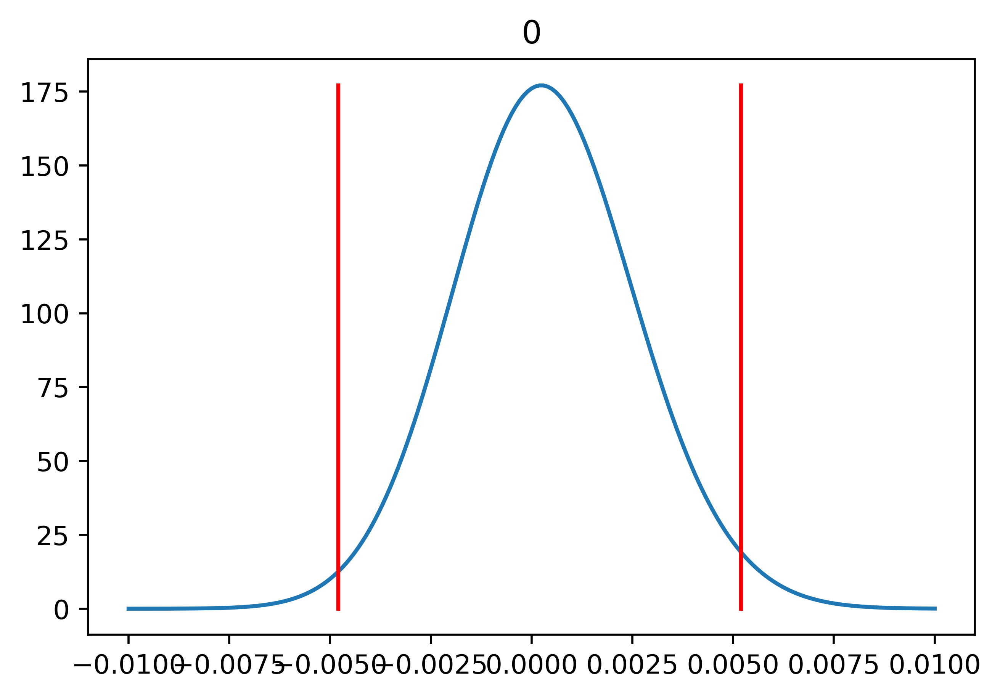

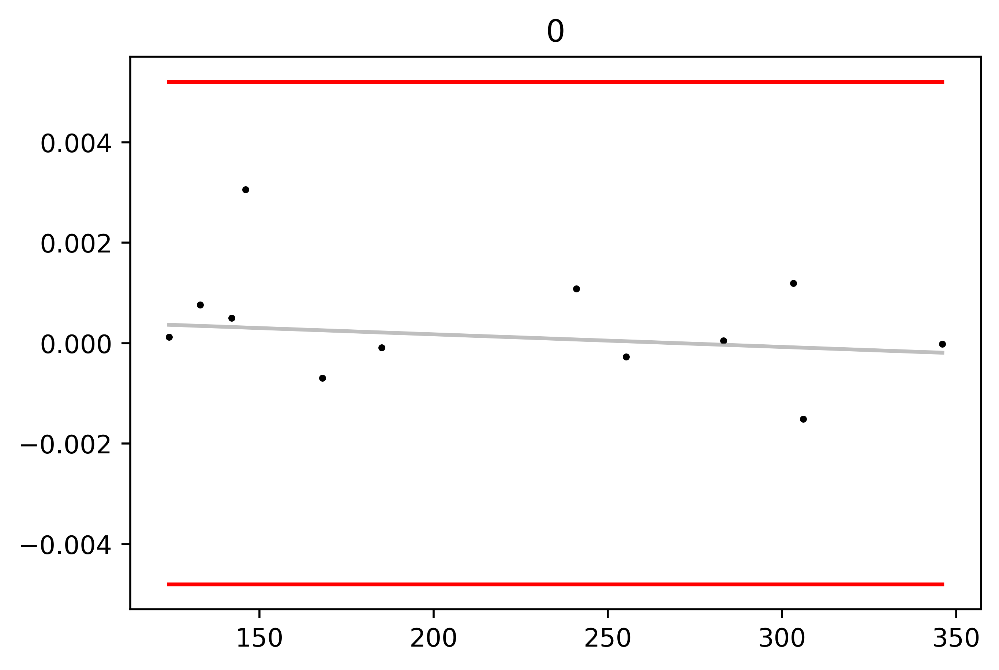

In [5]:
if __name__ == "__main__":
    tolerance = 0.01
    step = 0.002
    dalim = 0.005
    file = [x for x in os.listdir(datadir+subdirs[0]) if ".imzML" in x and "recal" not in x][1]
    filt = peaklist[peaklist[subdirs[0]] > 0.5]
    mzsCorr = list(filt["mz"].values)
    mzsCorr.sort()
    SIMSIToolBox.recalibration.visualizeParameters(datadir + subdirs[0] + "/" + file,1,tolerance,mzsCorr,step,dalim)



In [6]:
if __name__ == "__main__":
    for subdir in subdirs:
        files = [x for x in os.listdir(datadir + subdir) if ".imzML" in x and "recal" not in x]
        filt = peaklist[peaklist[subdir] > 0.5]
        mzsCorr = list(filt["mz"].values)
        mzsCorr.sort()
        for file in files:
            if file.replace(".imzML","_recal.imzML") not in os.listdir(datadir + subdir):
                print(file)
                SIMSIToolBox.recalibration.write_corrected_msi(datadir + subdir + "/" + file,datadir + subdir + "/" + file.replace(".imzML","_recal.imzML"),tolerance,mzsCorr,step,dalim,numCores=num_cores)



In [7]:
mzs = []
keys = []
for index,row in peaklist.iterrows():
    _,_,nC = SIMSIToolBox.getMzsOfIsotopologues(row["formula"],"C")
    for x in range(nC+1):
        mzs.append(row["mz"] + 1.00336 * x)
        keys.append((index,x))
print(len(mzs))

172


In [8]:
inds = []
for index,row in peaklist.iterrows():
    tmp = [x for x in range(len(keys)) if keys[x][0] == index]
    tmp.sort(key=lambda x: keys[x][1])
    inds.append(tmp)
peaklist["inds"] = inds
peaklist

,ion,formula,adduct,mz,name,labeling trend,pool size trend in tumor,14x,12x,10x,8x,100um,50um,comment,moleculeNames,moleculeIds,for_paper,inds
0,C10H14N5O7P-H-,C10H14N5O7P,M-H,346.055729,AMP,1,1,0,1,0,0,1,1,NaN,"Adenosine monophosphate, 2'-Deoxyguanosine 5'-...","HMDB0000045, HMDB0001044, HMDB0003540, HMDB001...",1,"[0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10]"
1,C10H17N3O6S-H-,C10H17N3O6S,M-H,306.076451,Glutathione,1,1,1,1,0,0,1,1,NaN,Glutathione,HMDB0000125,0,"[11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21]"
2,C10H9N-H-,C10H9N,M-H,142.066144,6-Methylquinoline,0,0,1,1,0,0,0,1,NaN,"6-Methylquinoline, 2-Aminonaphthalene, Quinaldine","HMDB0033115, HMDB0041802, HMDB0042004",0,"[22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32]"
3,C12H14N2-H-,C12H14N2,M-H,185.108343,Detomidine,0,0,0,1,0,0,1,1,NaN,"1,2,3,4-Tetrahydro-2-methyl-b-carboline, 1-Phe...","HMDB0029836, HMDB0037144, HMDB0041872",0,"[33, 34, 35, 36, 37, 38, 39, 40, 41, 42, 43, 4..."
4,C16H32O2-H-,C16H32O2,M-H,255.232875,Palmitate,1,1,0,1,0,0,1,1,some interference at 14x 50 um,"Butyl dodecanoate, Dodecyl butyrate, Hexyl dec...","HMDB0032065, HMDB0032249, HMDB0032324, HMDB000...",1,"[46, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 5..."
5,C18H36O2-H-,C18H36O2,M-H,283.264176,Stearate,1,1,0,1,0,0,0,1,NaN,"Stearic acid, Ethyl hexadecanoate, 16-Methylhe...","HMDB0000827, HMDB0029811, HMDB0031066, HMDB006...",1,"[63, 64, 65, 66, 67, 68, 69, 70, 71, 72, 73, 7..."
6,C20H32O2-H-,C20H32O2,M-H,303.232875,Arachidonate,1,1,0,1,0,0,1,1,NaN,"ent-17-Hydroxy-16beta-kauran-19-al, Arachidoni...","HMDB0036721, HMDB0001043, HMDB0002177, HMDB000...",0,"[82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 9..."
7,C2H7NO3S-H-,C2H7NO3S,M-H,124.007309,Taurine,0,0,1,1,1,0,1,1,NaN,Taurine,HMDB0000251,0,"[103, 104, 105]"
8,C3H7O7P-H-,C3H7O7P,M-H,184.985584,2PG,0,0,1,0,0,0,1,0,NaN,"2-Phosphoglyceric acid, 3-Phosphoglyceric acid...","HMDB0000362, HMDB0000807, HMDB0003391, HMDB006...",0,"[106, 107, 108, 109]"
9,C4H12NO4P-H-,C4H12NO4P,M-H,168.043039,Phosphodimethylethanolamine,0,0,1,1,1,1,1,1,NaN,Phosphodimethylethanolamine,HMDB0060244,0,"[110, 111, 112, 113, 114]"


extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities |██████████████████████████████████████████████████| 100.0% 
forming matrix |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 
extracting intensities

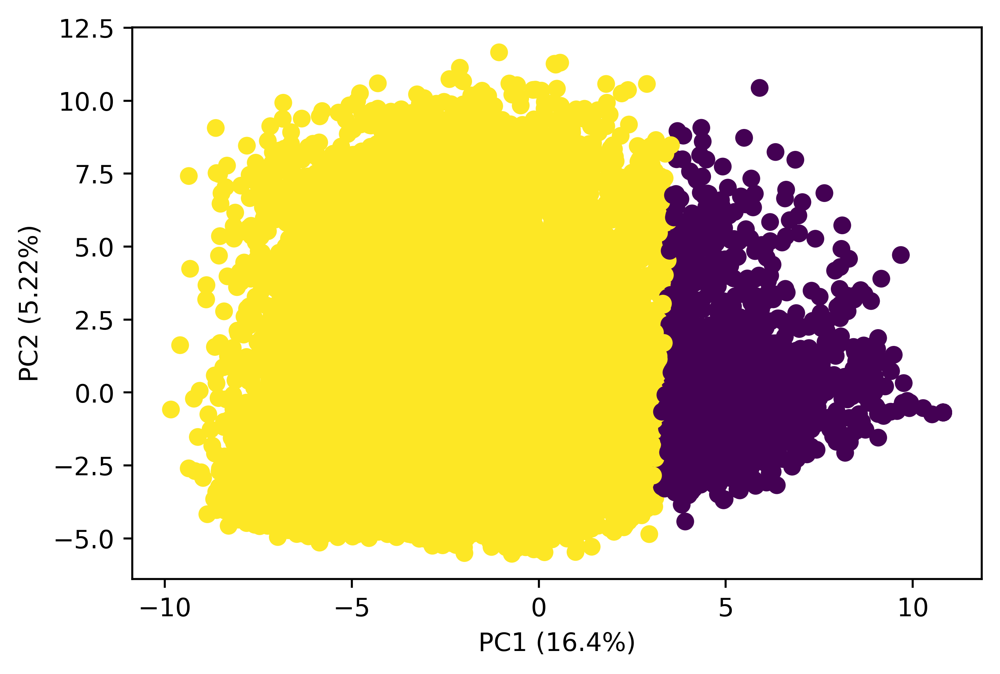

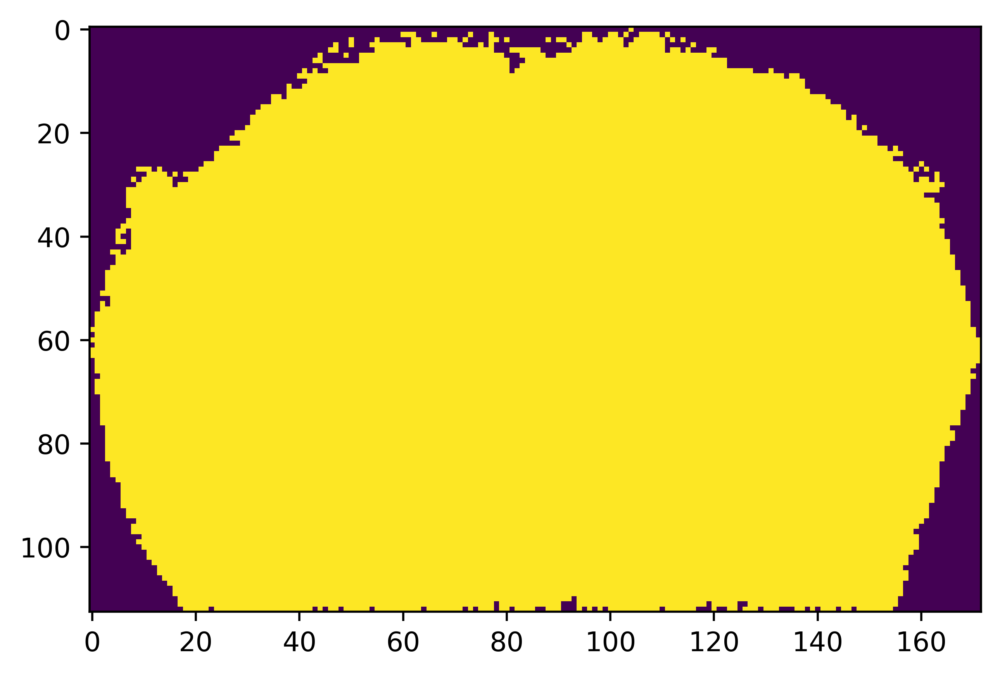

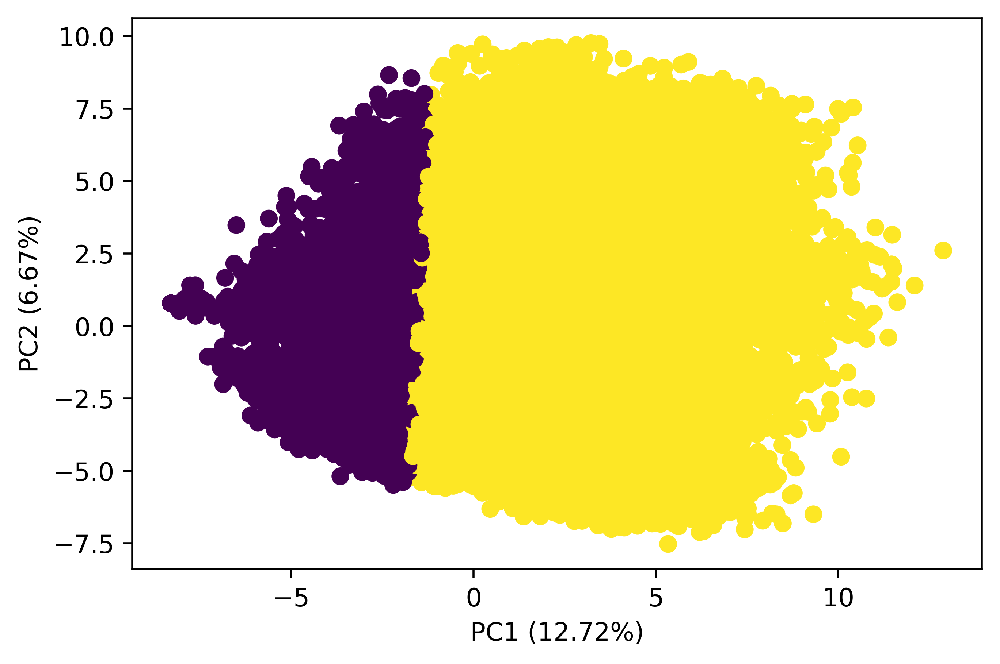

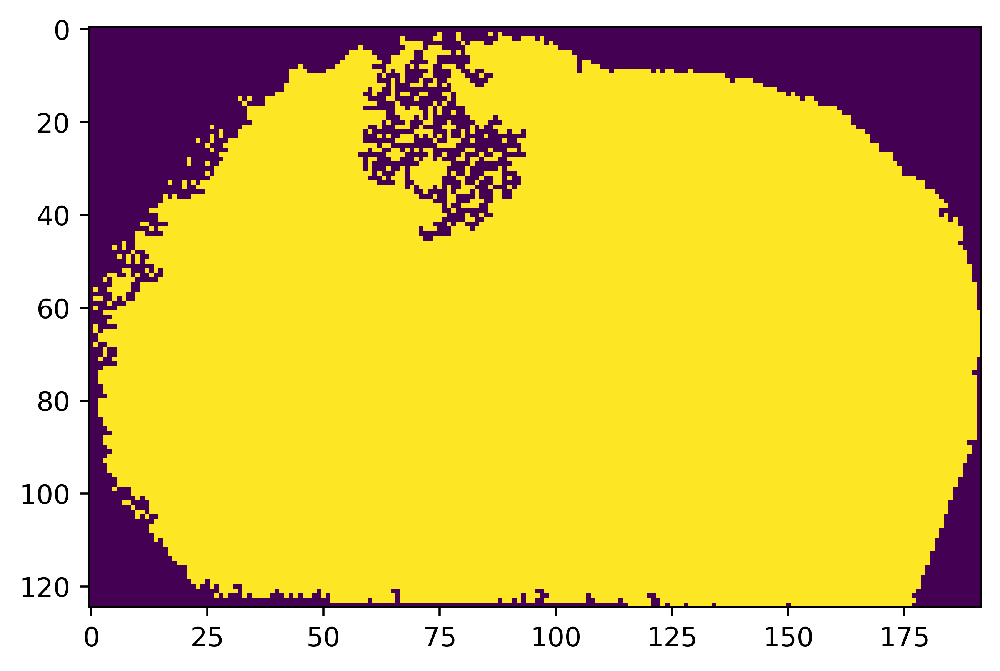

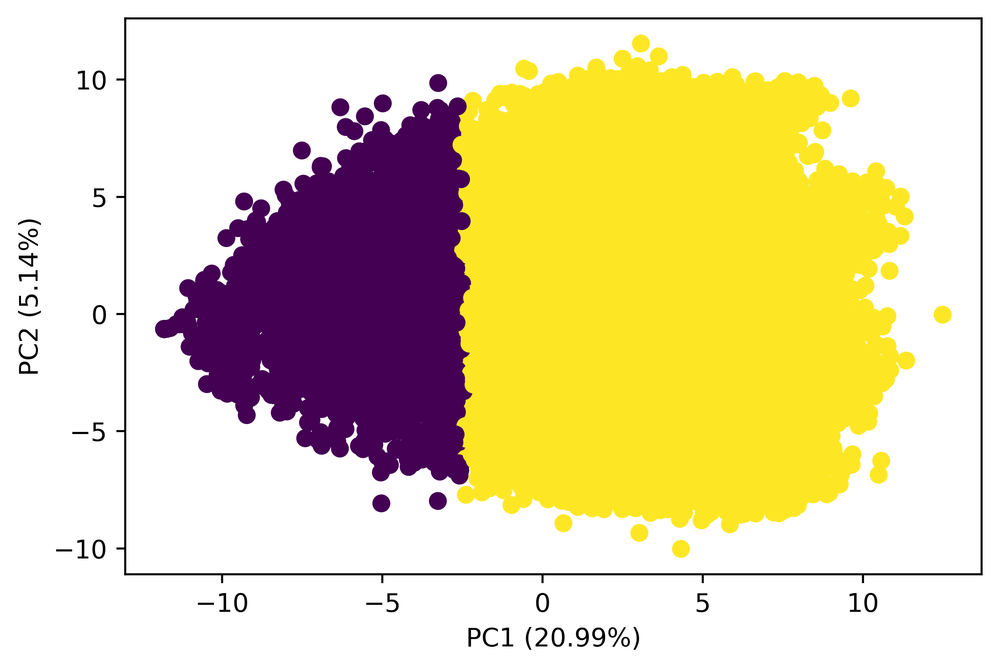

...

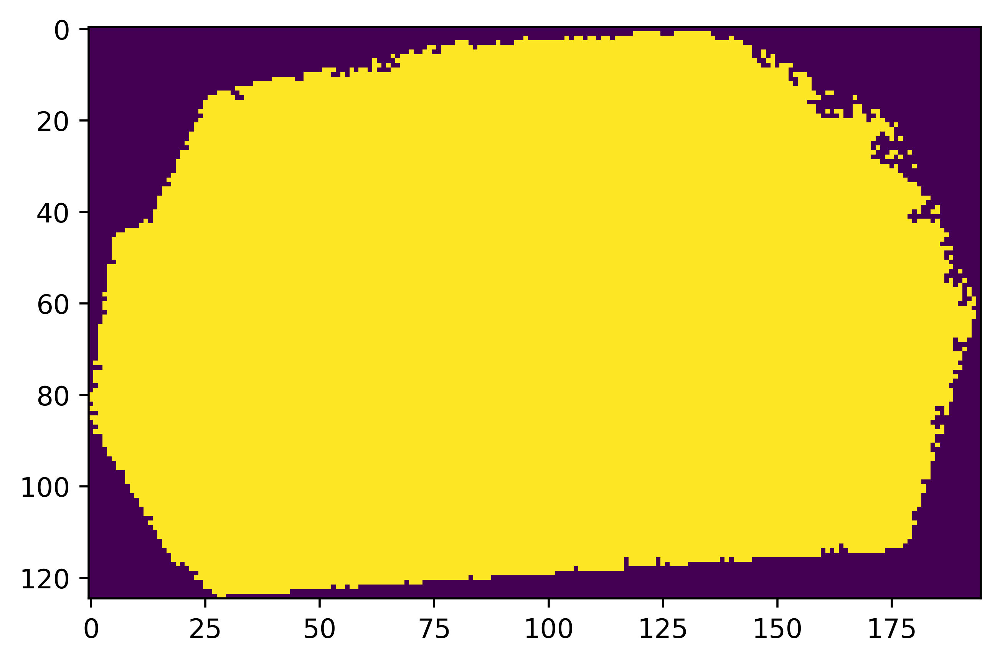

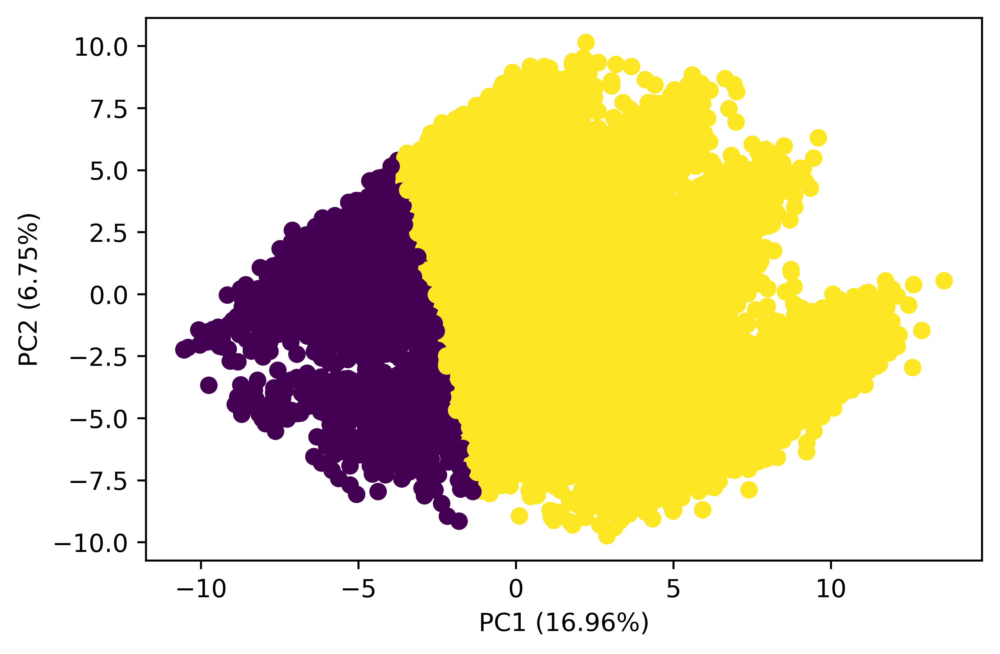

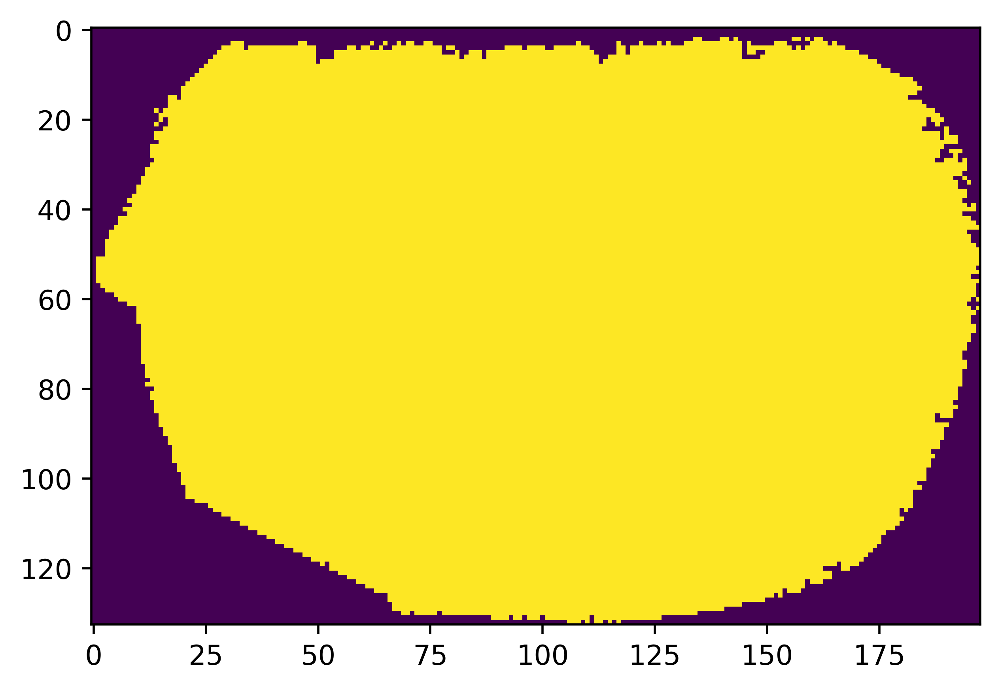

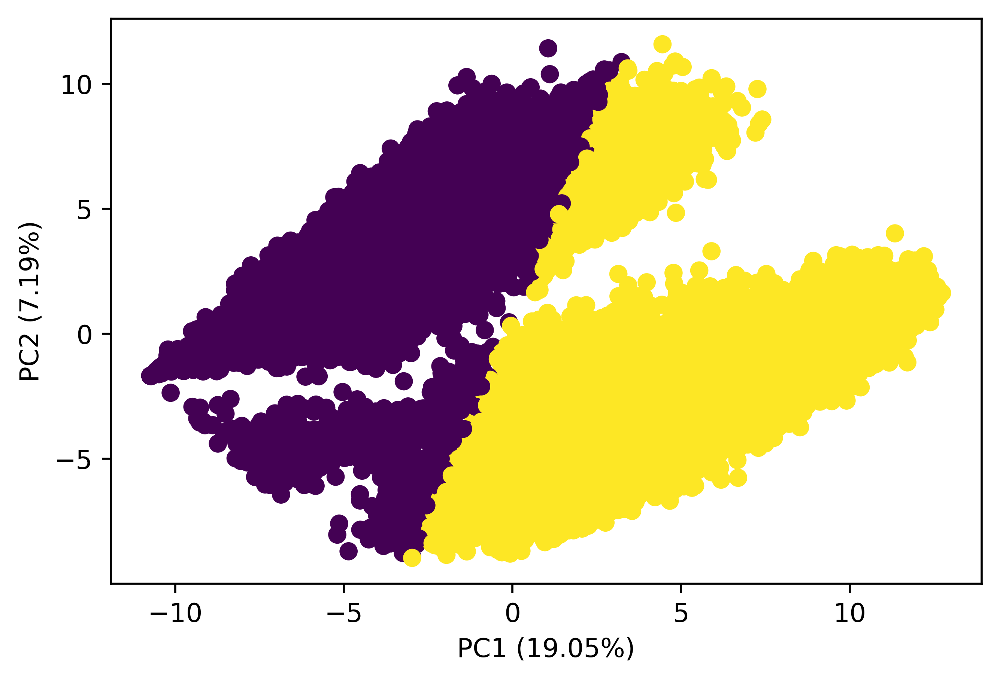

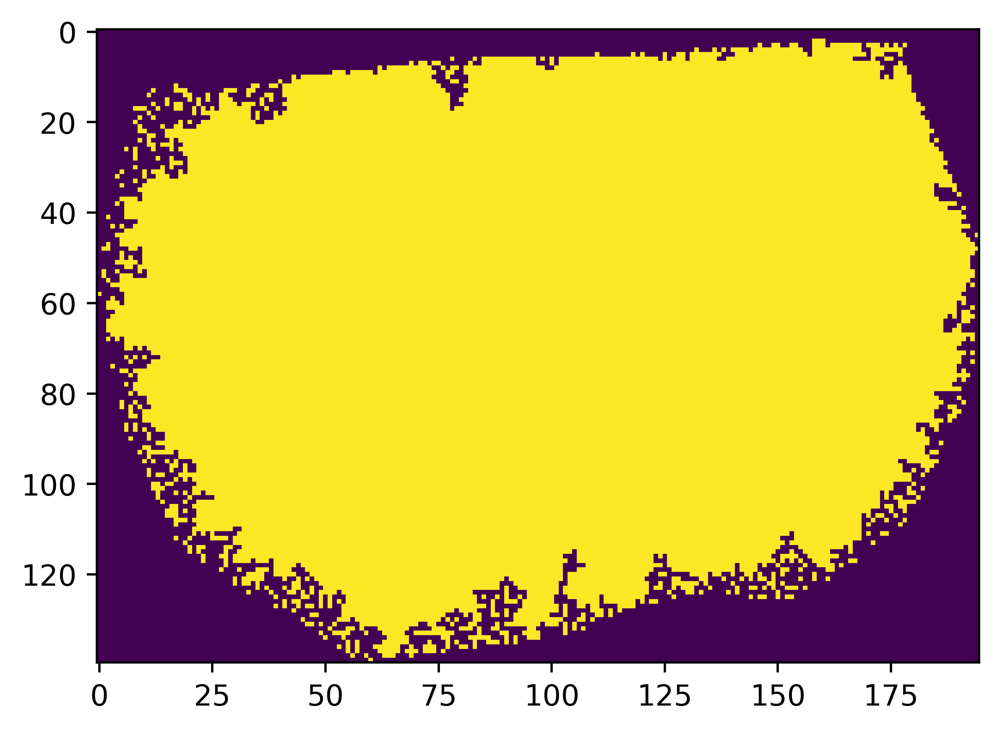

In [9]:
if __name__ == "__main__":
    msis = {}
    for subdir in subdirs:
        files = [x for x in os.listdir(datadir + subdir) if "_recal.imzML" in x]
        msis[subdir] = {}
        for file in files:
            msi = SIMSIToolBox.MSIData(mzs,ppm=ppmThresh,numCores = num_cores,intensityCutoff=intensityCutoff)
            msi.readimzML(datadir + subdir + "/" + file)
            msi.segmentImage(method=seg_method, num_latent=num_components, dm_method=dm_method,fill_holes = True)
            plt.figure()
            plt.imshow(msi.imageBoundary)
            msi.smoothData(filtMethod,convSquare)
            msi.correctNaturalAbundance(peaklist["formula"].values,peaklist["inds"].values)
            msis[subdir][file] = msi



extracting intensities |██████████████████████████████████████████████████| 100.0% 
Smoothing data |██████████████████████████████████████████████████| 100.0% 
correcting natural abundance |██████████████████████████████████████████████████| 100.0% 


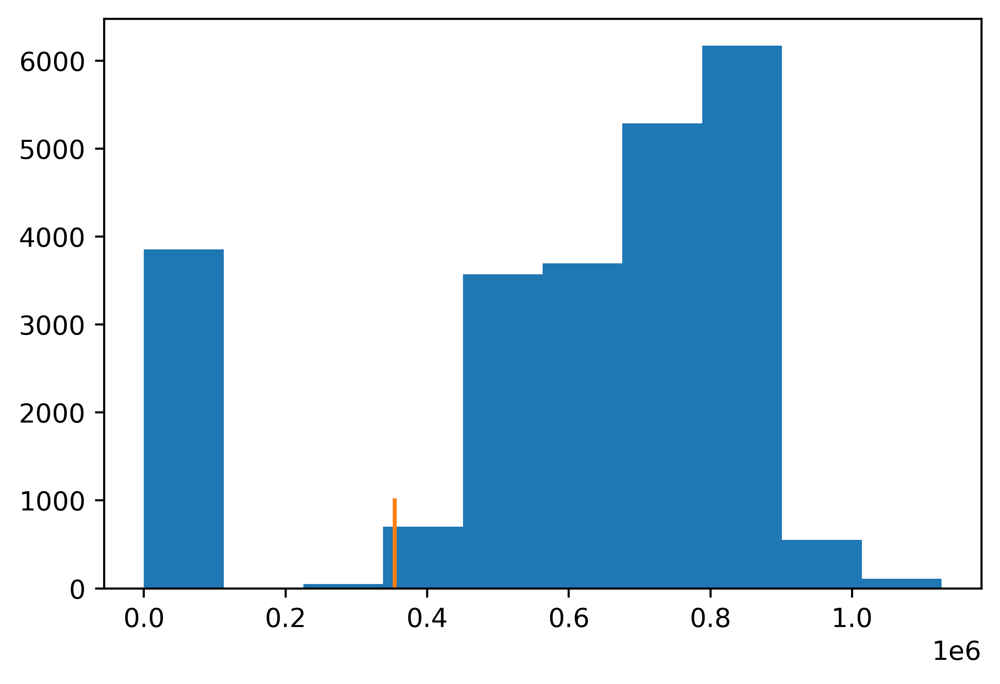

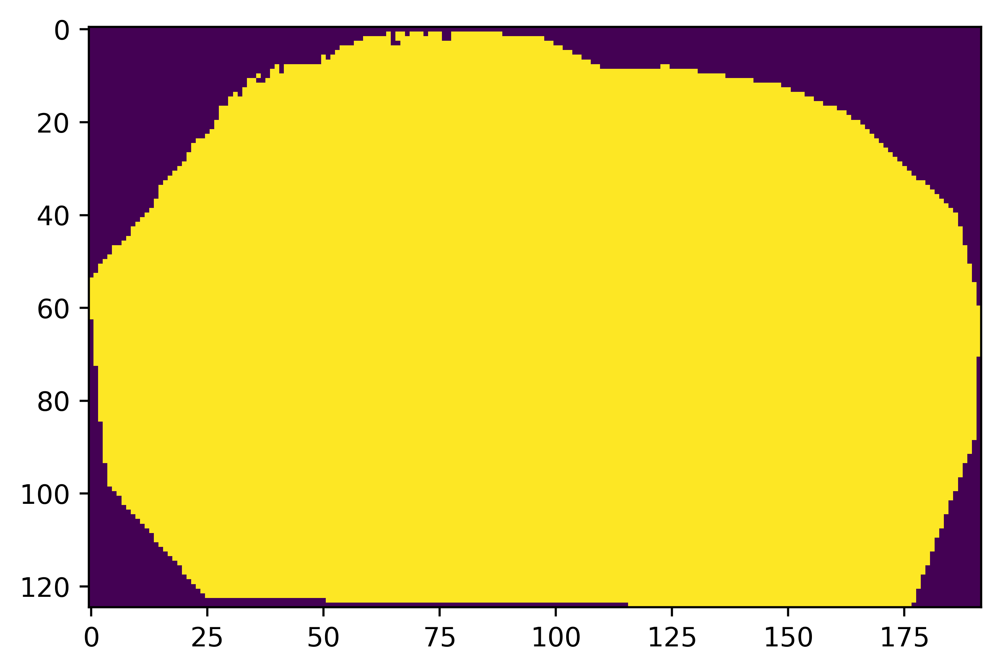

In [10]:
#resegment
if __name__ == "__main__":
    subdir = "12x"
    file = "4-2_10F-I_nedc_50um_12x_recal.imzML"
    msi = SIMSIToolBox.MSIData(mzs,ppm=ppmThresh,numCores = num_cores,intensityCutoff=intensityCutoff)
    msi.readimzML(datadir + subdir + "/" + file)
    msi.segmentImage(method="TIC_auto",fill_holes = True)
    plt.figure()
    plt.imshow(msi.imageBoundary)
    msi.smoothData(filtMethod,convSquare)
    msi.correctNaturalAbundance(peaklist["formula"].values,peaklist["inds"].values)
    msis[subdir][file] = msi



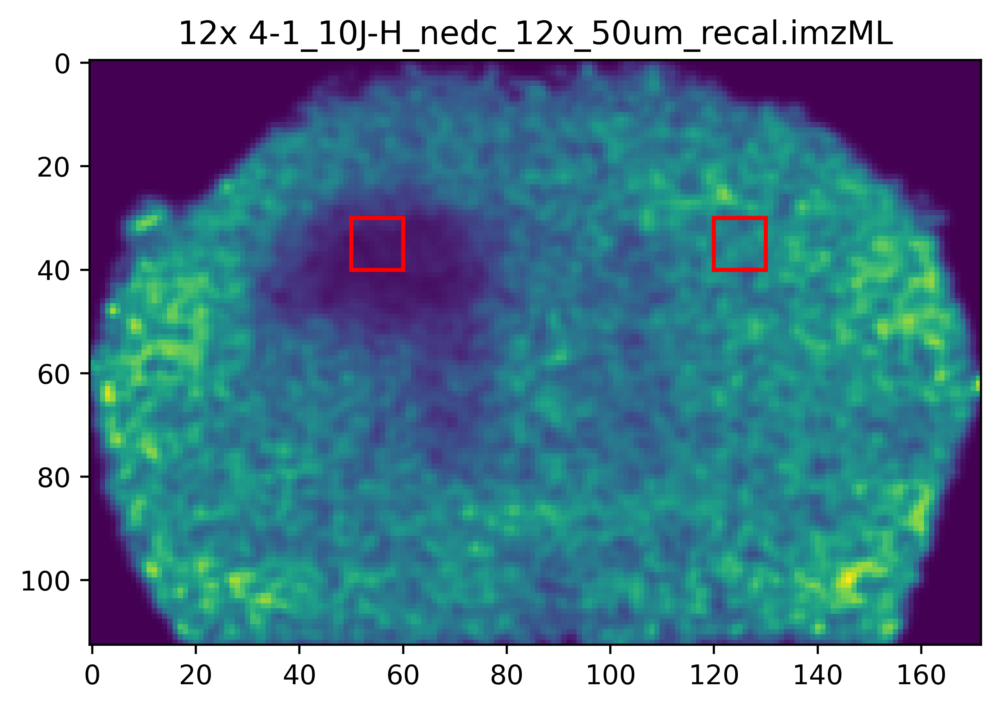

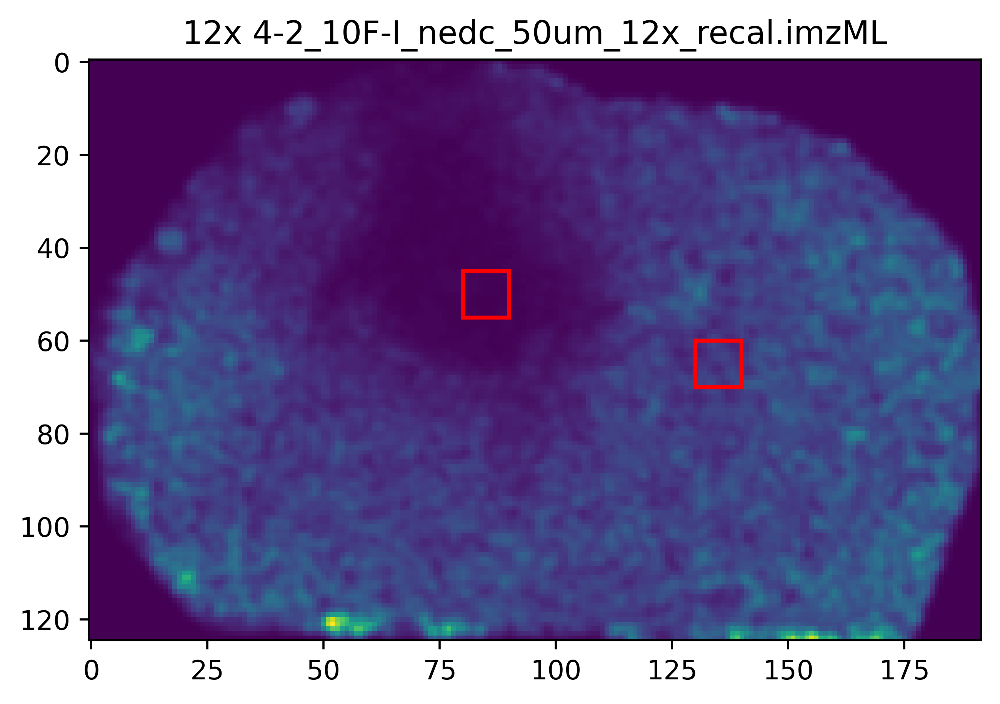

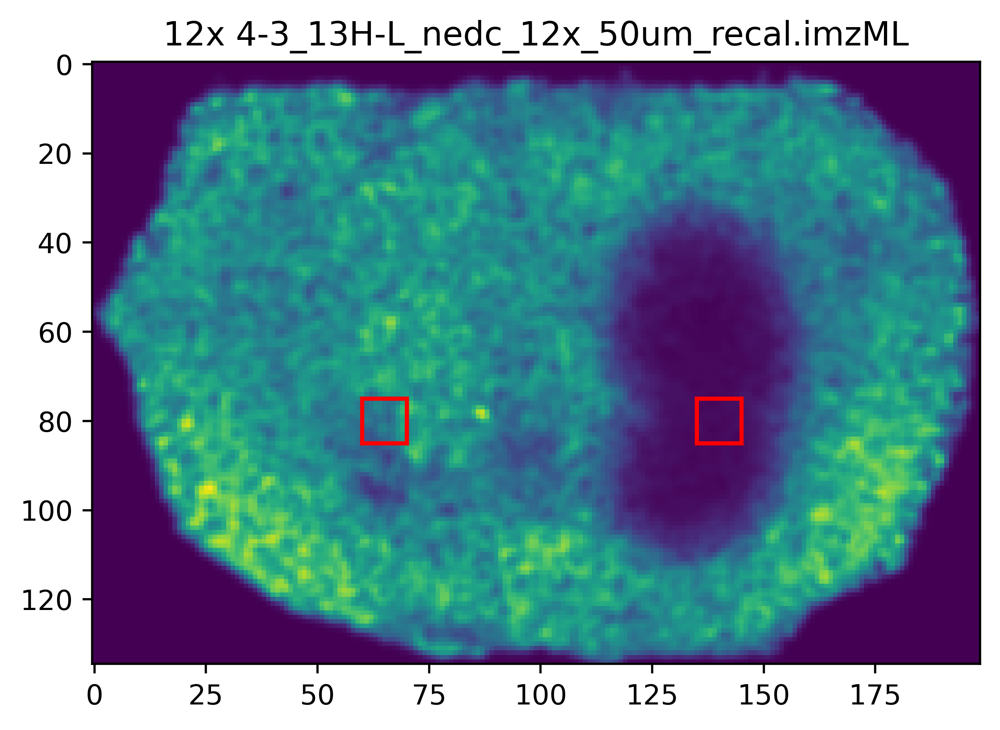

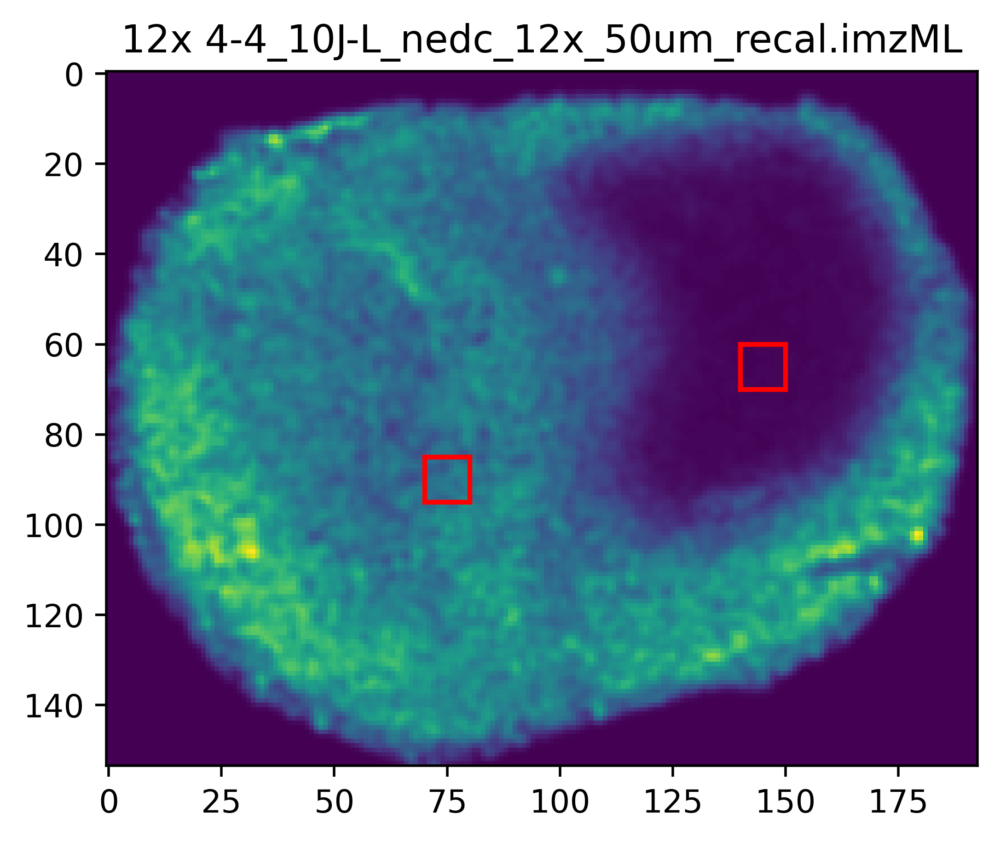

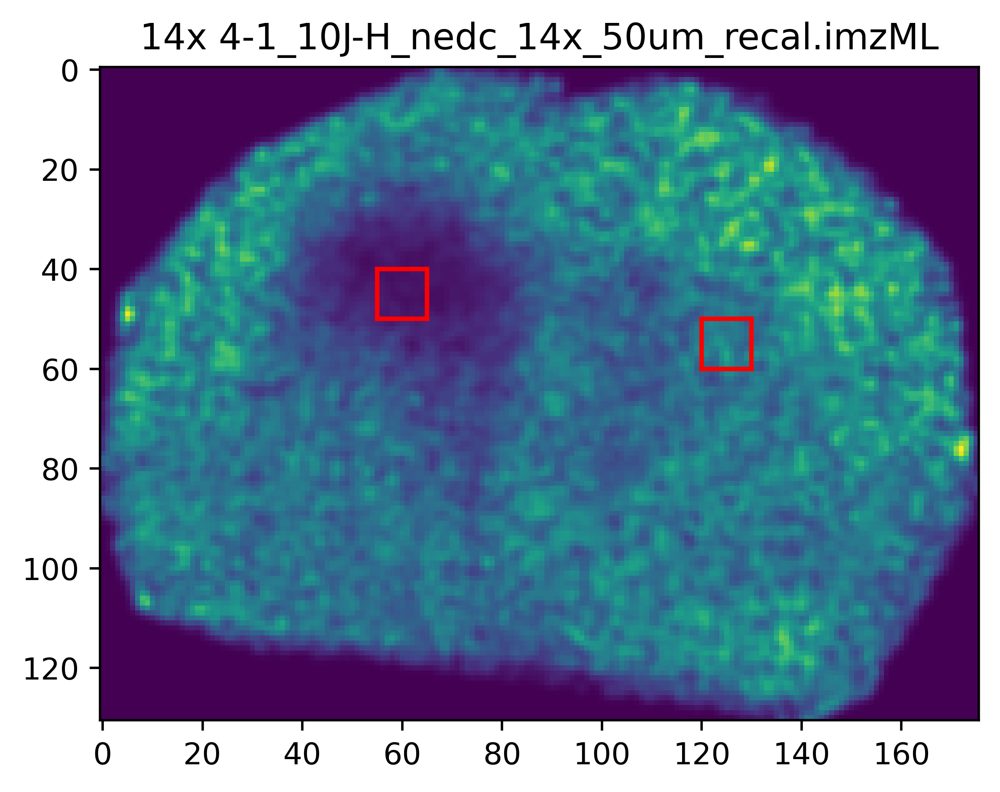

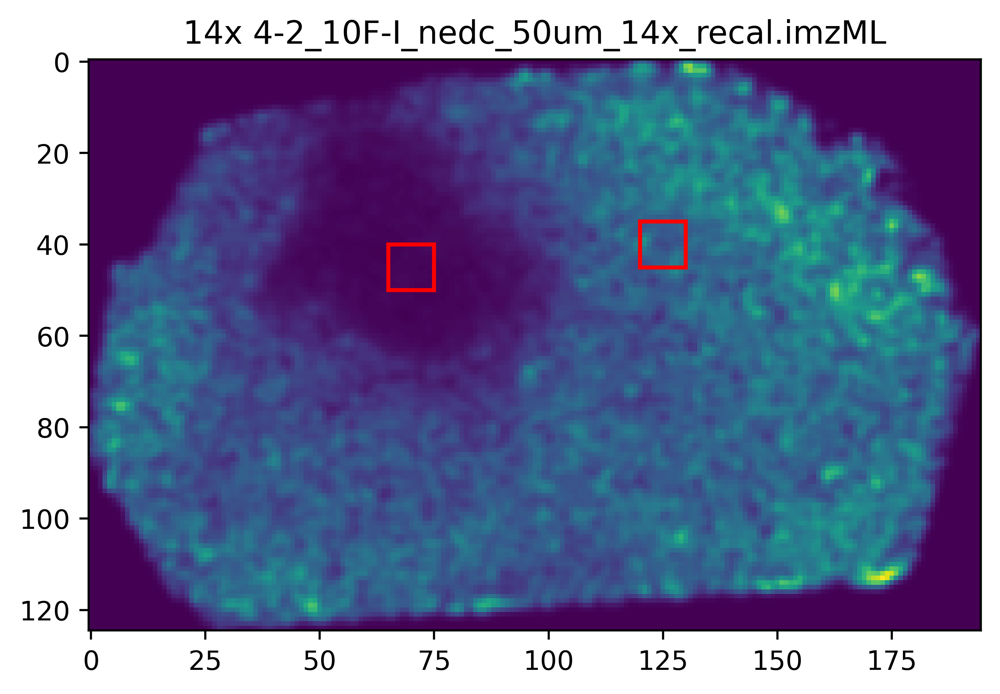

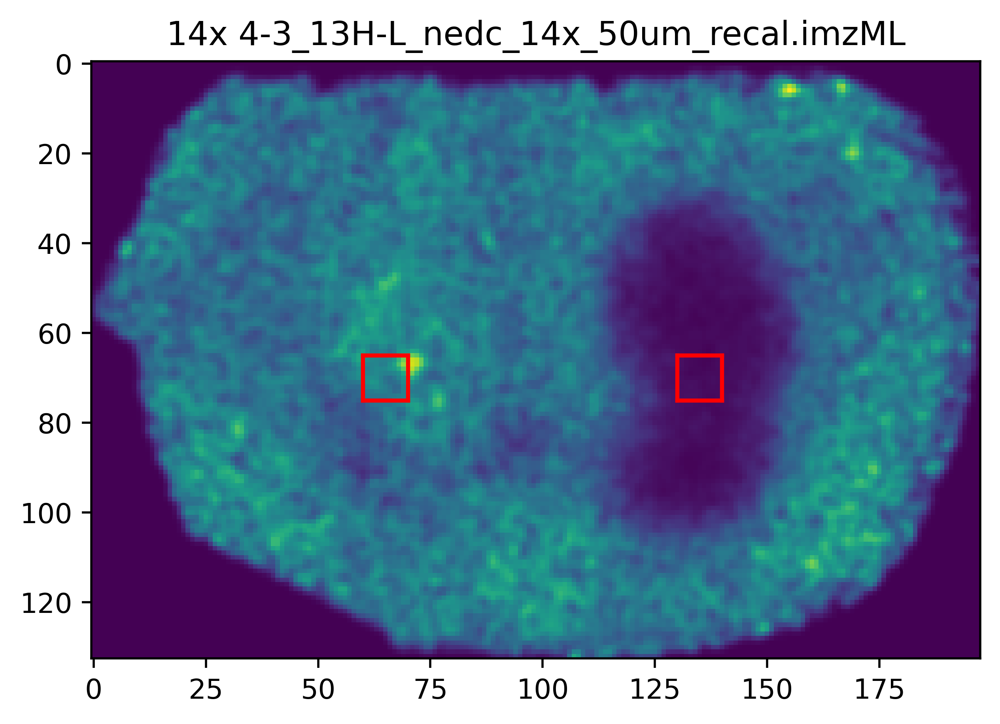

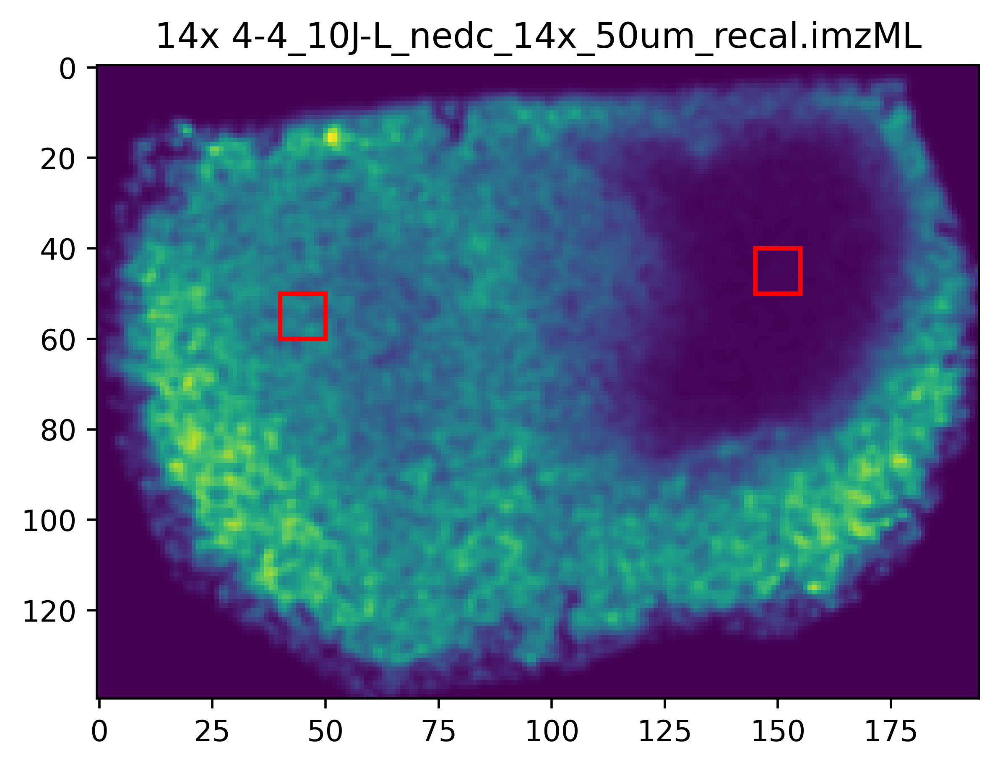

In [10]:
boxSize = 10
boxBoundaries = {"12x":{'4-1_10J-H_nedc_12x_50um_recal.imzML':{"i":[[50,50+boxSize],[30,30+boxSize]],"c":[[120,120+boxSize],[30,30+boxSize]]},
                        '4-2_10F-I_nedc_50um_12x_recal.imzML':{"i":[[80,80+boxSize],[45,45+boxSize]],"c":[[130,130+boxSize],[60,60+boxSize]]},
                        '4-3_13H-L_nedc_12x_50um_recal.imzML':{"i":[[135,135+boxSize],[75,75+boxSize]],"c":[[60,60+boxSize],[75,75+boxSize]]},
                        '4-4_10J-L_nedc_12x_50um_recal.imzML':{"i":[[140,140+boxSize],[60,60+boxSize]],"c":[[70,70+boxSize],[85,85+boxSize]]}},
                 "14x":{'4-1_10J-H_nedc_14x_50um_recal.imzML':{"i":[[55,55+boxSize],[40,40+boxSize]],"c":[[120,120+boxSize],[50,50+boxSize]]}, 
                        '4-2_10F-I_nedc_50um_14x_recal.imzML':{"i":[[65,65+boxSize],[40,40+boxSize]],"c":[[120,120+boxSize],[35,35+boxSize]]},
                        '4-3_13H-L_nedc_14x_50um_recal.imzML':{"i":[[130,130+boxSize],[65,65+boxSize]],"c":[[60,60+boxSize],[65,65+boxSize]]},
                        '4-4_10J-L_nedc_14x_50um_recal.imzML':{"i":[[145,145+boxSize],[40,40+boxSize]],"c":[[40,40+boxSize],[50,50+boxSize]]}}}

def plotBox(xmin,xmax,ymin,ymax,color):
    plt.plot([xmin,xmax],[ymin,ymin],color)
    plt.plot([xmin,xmax],[ymax,ymax],color)
    plt.plot([xmin,xmin],[ymin,ymax],color)
    plt.plot([xmax,xmax],[ymin,ymax],color)
    
def addBox(xmin,xmax,ymin,ymax,color,image):
    image = deepcopy(image)
    image[xmin:xmax+1,ymin] = color
    image[xmin:xmax+1,ymax] = color
    image[xmin,ymin:ymax+1] = color
    image[xmax,ymin:ymax+1] = color
    return image

for subdir in subdirs:
    for fn in msis[subdir]:
        plt.figure()
        naainds = [157, 158, 159, 160, 161, 162, 163]
        plt.imshow(msis[subdir][fn].data_tensor[naainds,:,:].sum(axis=0))
        plt.title(subdir + " " + fn)    
        
        box1 = boxBoundaries[subdir][fn]["i"]
        box2 = boxBoundaries[subdir][fn]["c"]

        plotBox(*box1[0],*box1[1],"red")
        plotBox(*box2[0],*box2[1],"red")


In [11]:


def extractLabelingPattern(data,xmin,xmax,ymin,ymax,badInds=[]):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    df  = {}
    aveLabelings = []
    for row in roi:
        for b in badInds:
            row[b] = 0.0
        aveLabelings.append(np.sum([x*row[x] for x in range(len(row))]) / len(row) * np.sum([row[x] for x in range(len(row))]))
        row = row / np.sum(row)
        for x in range(len(row)):
           df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":row[x]}

    df = pd.DataFrame.from_dict(df,orient="index")
    print(np.mean(aveLabelings),np.std(aveLabelings))
    return df

def extractLabelingPatternForStacked(data,xmin,xmax,ymin,ymax):

    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(data[:,x,y])
    roi = np.array(roi)
    
    roi = roi.mean(axis=0)
    
    df  = {}
    for x in range(len(roi)):
       df[len(df)] = {"isotopologue":"M"+str(x),"Isotopologue Fraction":roi[x]}

    df = pd.DataFrame.from_dict(df,orient="index")
    
    df = df.set_index("isotopologue")

    return df


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 4-1_10J-H_nedc_12x_50um_recal.imzML ips
0.43851799265576835 0.03934736474627697
C10H14N5O7P 4-1_10J-H_nedc_12x_50um_recal.imzML cont
0.19826715331482353 0.055655197083177586


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 4-2_10F-I_nedc_50um_12x_recal.imzML ips
0.35656169195569504 0.047497569953813754
C10H14N5O7P 4-2_10F-I_nedc_50um_12x_recal.imzML cont
0.1568924661858958 0.03176347614352084


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 4-3_13H-L_nedc_12x_50um_recal.imzML ips
0.4609758916662043 0.03931894846338873
C10H14N5O7P 4-3_13H-L_nedc_12x_50um_recal.imzML cont
0.1685282502614591 0.03875962744517313


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C10H14N5O7P 4-4_10J-L_nedc_12x_50um_recal.imzML ips
0.4917923674290758 0.019059429817473068


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:105: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


C10H14N5O7P 4-4_10J-L_nedc_12x_50um_recal.imzML cont
0.27256252006037085 0.06121520126505157


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 4-1_10J-H_nedc_12x_50um_recal.imzML ips
0.23575625143255644 0.04873461666042991
C16H32O2 4-1_10J-H_nedc_12x_50um_recal.imzML cont
0.057617387318590244 0.02112914053976106


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 4-2_10F-I_nedc_50um_12x_recal.imzML ips
0.24148589079630764 0.05490313810208299
C16H32O2 4-2_10F-I_nedc_50um_12x_recal.imzML cont
0.09813111095044362 0.05043135605572804


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 4-3_13H-L_nedc_12x_50um_recal.imzML ips
0.3150640033226638 0.06330764552485466
C16H32O2 4-3_13H-L_nedc_12x_50um_recal.imzML cont
0.057244226646566934 0.025833064488097197


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C16H32O2 4-4_10J-L_nedc_12x_50um_recal.imzML ips
0.29164088024256046 0.042770057803616875
C16H32O2 4-4_10J-L_nedc_12x_50um_recal.imzML cont
0.10777604321689313 0.028821677705336765


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 4-1_10J-H_nedc_12x_50um_recal.imzML ips
0.10476440536836232 0.025770755524803467
C18H36O2 4-1_10J-H_nedc_12x_50um_recal.imzML cont
0.004231981458600494 0.0017833748903322865


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 4-2_10F-I_nedc_50um_12x_recal.imzML ips
0.1382167593126237 0.045579066064408306
C18H36O2 4-2_10F-I_nedc_50um_12x_recal.imzML cont
0.011673334440138702 0.010872396642472526


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 4-3_13H-L_nedc_12x_50um_recal.imzML ips
0.12452396571669673 0.03467025501083093
C18H36O2 4-3_13H-L_nedc_12x_50um_recal.imzML cont
0.006727698906140511 0.003481397529312216


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C18H36O2 4-4_10J-L_nedc_12x_50um_recal.imzML ips
0.16200731886562028 0.02752010647739619
C18H36O2 4-4_10J-L_nedc_12x_50um_recal.imzML cont
0.009733464710612386 0.002910665438632079


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 4-1_10J-H_nedc_14x_50um_recal.imzML ips
0.5338223009680019 0.06910109570605777
C6H9NO5 4-1_10J-H_nedc_14x_50um_recal.imzML cont
0.5333741741317389 0.04405556245413648


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 4-2_10F-I_nedc_50um_14x_recal.imzML ips
0.441238786663855 0.07522401583367685
C6H9NO5 4-2_10F-I_nedc_50um_14x_recal.imzML cont
0.46253098977587354 0.05449093158795859


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 4-3_13H-L_nedc_14x_50um_recal.imzML ips
0.559292225185934 0.05915885213357671
C6H9NO5 4-3_13H-L_nedc_14x_50um_recal.imzML cont
0.5934280055227088 0.038140046908265966


c:\users\ethan\appdata\local\programs\python\python37\lib\site-packages\ipykernel_launcher.py:71: RuntimeWarning: invalid value encountered in true_divide


C6H9NO5 4-4_10J-L_nedc_14x_50um_recal.imzML ips
0.46198154864467955 0.0804012132761387
C6H9NO5 4-4_10J-L_nedc_14x_50um_recal.imzML cont
0.5553321975214839 0.029379315662378423


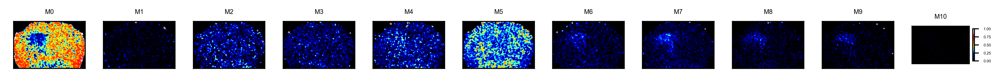

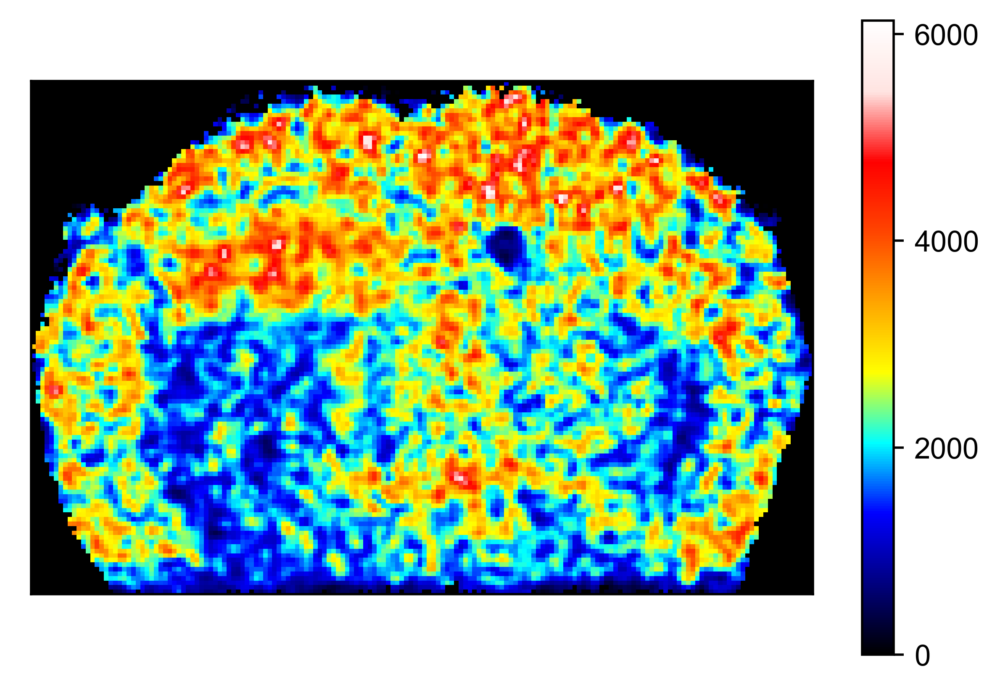

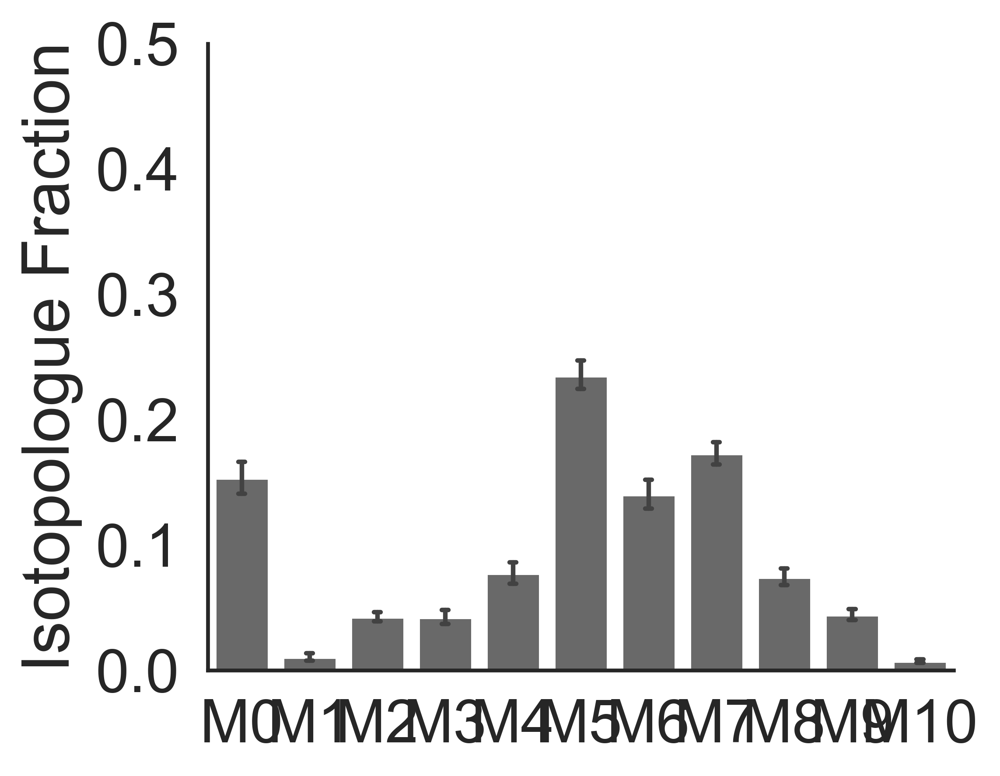

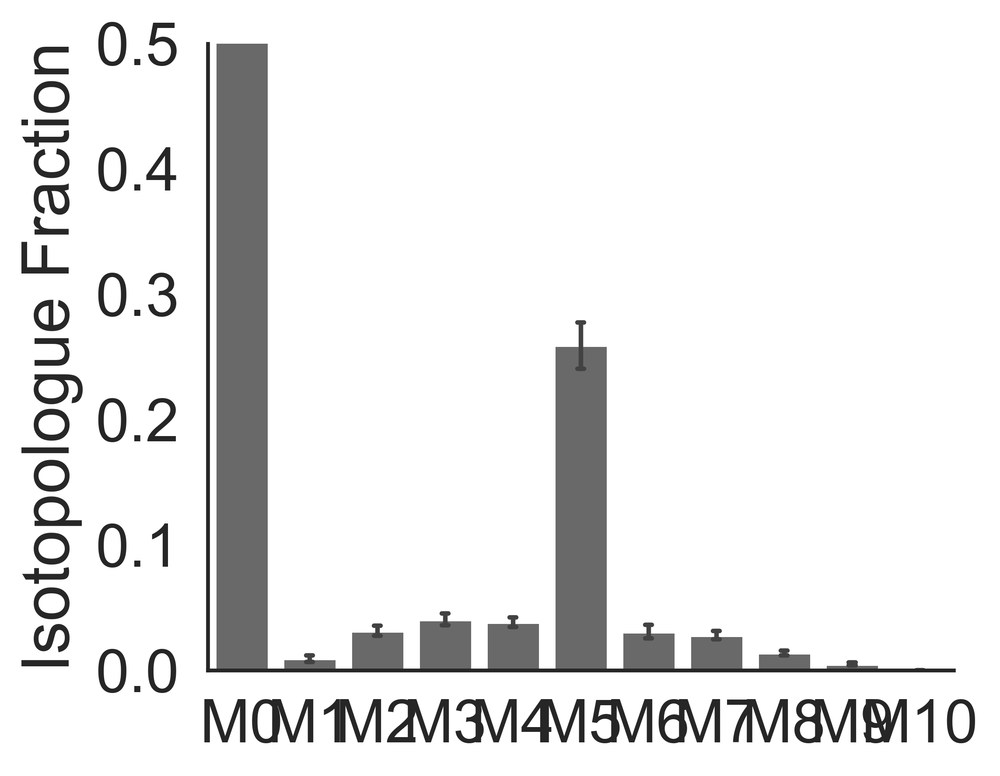

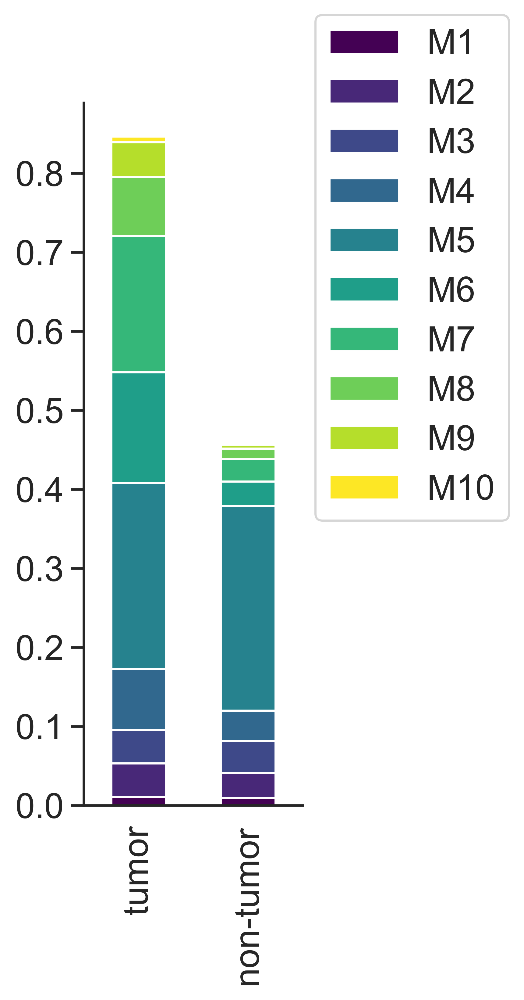

...

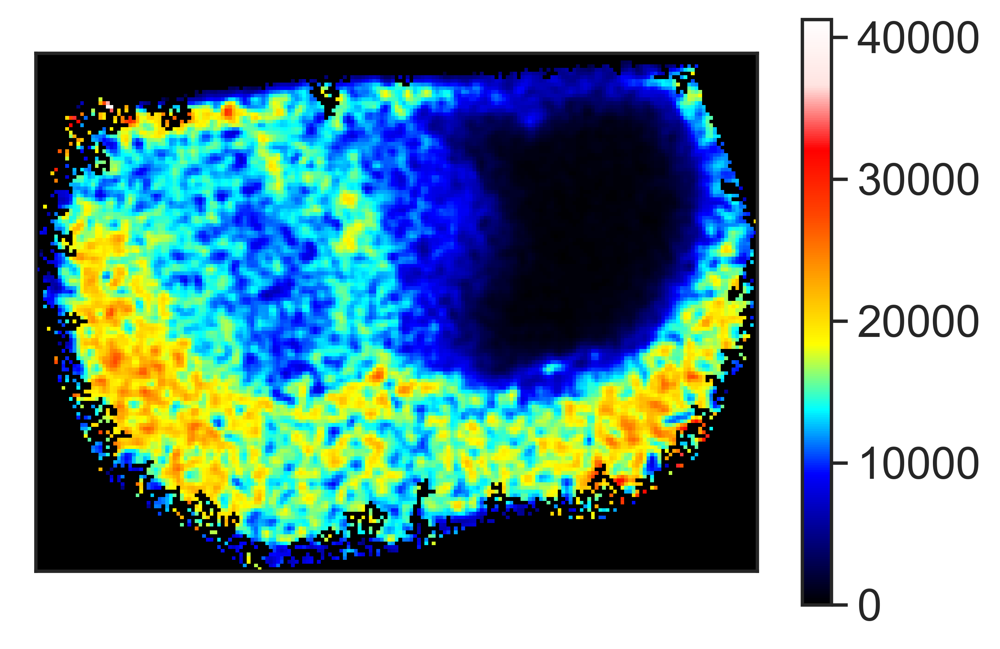

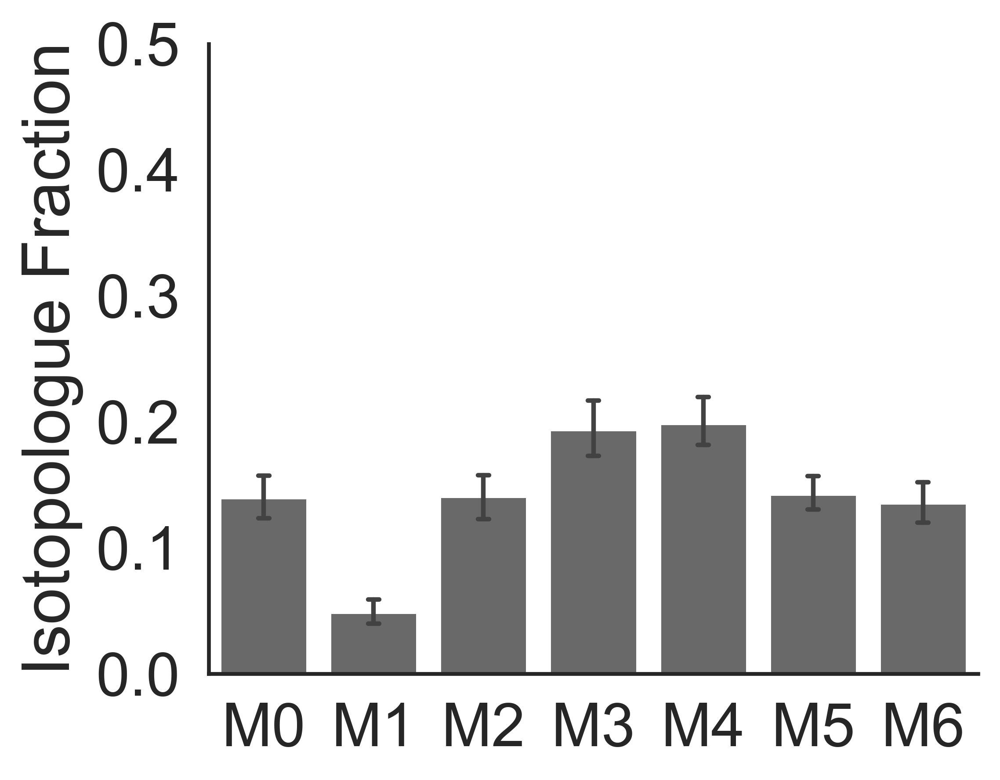

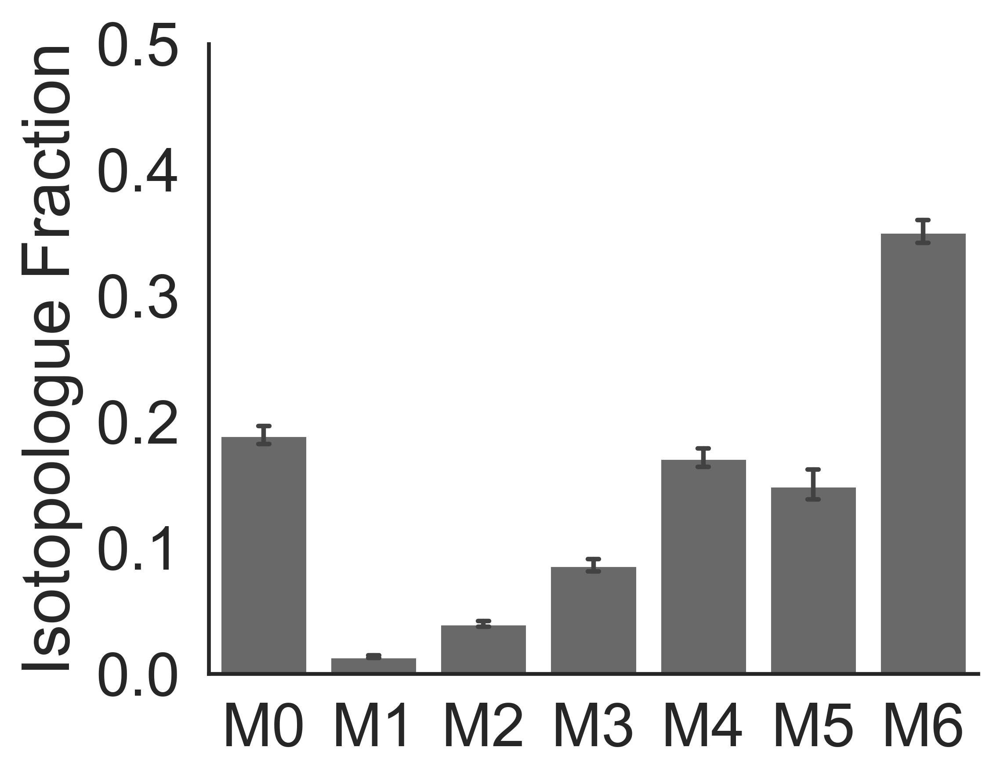

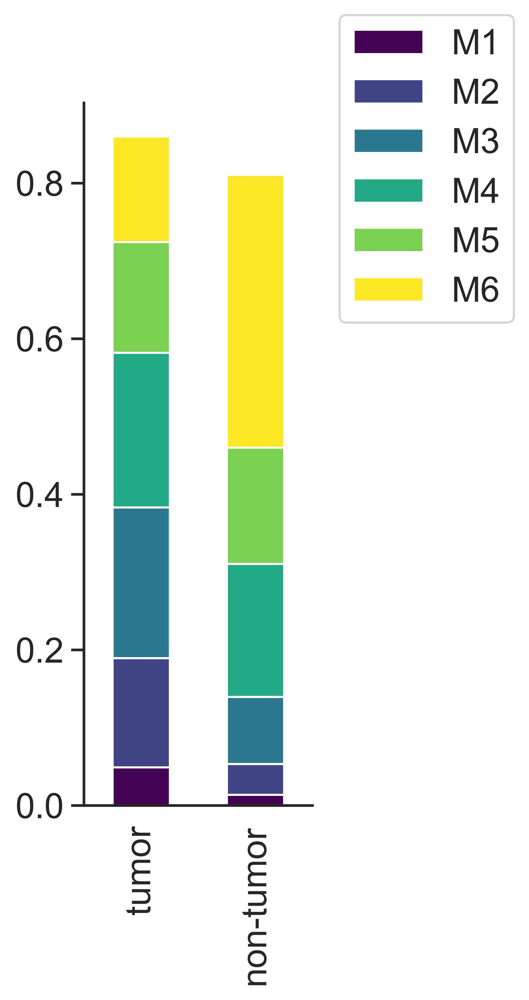

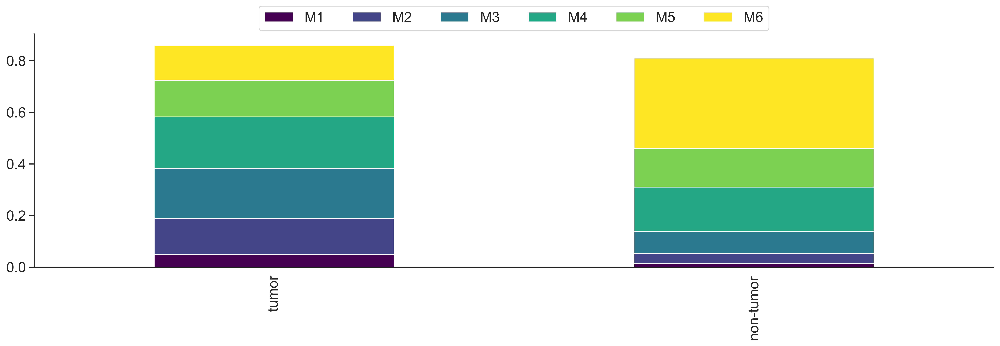

In [12]:
for subdir in subdirs:
    for fn in msis[subdir]:
        try: os.mkdir(datadir + subdir + "/" + fn.replace(".imzML",""))
        except: pass
    
maxLabs = {"C16H32O2":[1.0 for x in range(2)] + [0.1 for x in range(15)],
           "C18H36O2":[1.0 for x in range(2)] + [0.1 for x in range(17)],
           "C6H9NO5":[1.0 for x in range(7)],
           "C10H14N5O7P":[1.0 for x in range(6)] + [0.25 for x in range(5)]}
badInds = {"C16H32O2":[1,2],
       "C18H36O2":[1,3],
       "C6H9NO5":[],
       "C10H14N5O7P":[]}

averageLabeling = {subdir : {} for subdir in msis}
    
for index,row2 in peaklist.iterrows():
    inds = row2["inds"]
    if row2["for_paper"] > 0.5:
        for subdir in subdirs:
            if row2[subdir] > 0.5:
                tmpLab = {}
                for x in range(len(inds)):
                    tmpLab[row2["formula"] + "_M" + str(x)] = {}
                for fn in msis[subdir]:
                    fig, axes = plt.subplots(1,len(inds),figsize=(len(inds),1))
                    tmp = msis[subdir][fn].data_tensor[inds]
                    isoTensor = SIMSIToolBox.normalizeTensor(tmp)
                    col = 0
                    for img in isoTensor:
                        ave = np.mean(img[msis[subdir][fn].imageBoundary > 0.5])
                        tmp = axes[col].imshow(img,cmap=colormap)
                        tmpLab[row2["formula"] + "_M" + str(col)][fn] = ave
                        axes[col].set_xticks([])
                        axes[col].set_yticks([])
                        axes[col].set_title("M"+str(col),fontsize=5)
                        if col == len(isoTensor) - 1:
                            cbar = plt.colorbar(tmp, ax=axes[col],shrink=0.5)
                            tmp.set_clim(0.0,1.0)
                            cbar.ax.tick_params(labelsize=3)
                        col += 1

                    plt.tight_layout()
                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_iso_all.png")

                    tmp = msis[subdir][fn].data_tensor[inds]
                    isoTensor = SIMSIToolBox.normalizeTensor(tmp)
                    maxLim = 1.0
                    counter = 0
                    
                    
                    for img in isoTensor:
                        norm = plt.Normalize(vmin=0, vmax=maxLabs[row2["formula"]][counter])
                        norm = colormap(norm(img))
                        for row in range(norm.shape[0]):
                            for col in range(norm.shape[1]):
                                if msis[subdir][fn].imageBoundary[row,col] < .5:
                                    norm[row,col,3] = 0
                        plt.imsave(datadir + subdir + "/" +  fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter) +".png",norm)#,cmap=colormap)
                        counter += 1

                    plt.figure()
                    SIMSIToolBox.showImage(img,cmap = colormap)
                    plt.clim(0,maxLim)
                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_M" + str(counter-1) +"_withColorBar.png")
                    plt.close()

                    tmp = msis[subdir][fn].data_tensor[[inds[x] for x in range(len(inds)) if x not in badInds[row2["formula"]]]]
                    poolSize = np.sum(tmp,axis=0)
                    meanInt = np.mean(msis[subdir][fn].tic_image[msis[subdir][fn].imageBoundary > 0.5])
                    poolSize = poolSize / msis[subdir][fn].tic_image
                    poolSize[msis[subdir][fn].imageBoundary < 0.5] = 0.0
                    poolSize = poolSize * meanInt
                    plt.figure()

                    SIMSIToolBox.showImage(poolSize,cmap = colormap)
                    maxLim = np.max(poolSize)
                    plt.clim(0,maxLim)
                    norm = plt.Normalize(vmin=0, vmax=maxLim)
                    norm = colormap(norm(poolSize))
                    for row in range(norm.shape[0]):
                        for col in range(norm.shape[1]):
                            if msis[subdir][fn].imageBoundary[row,col] < .5:
                                norm[row,col,3] = 0
                    plt.imsave(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_pool.png",norm)#,cmap=colormap)
                    
                    box1 = boxBoundaries[subdir][fn]["i"]
                    box2 = boxBoundaries[subdir][fn]["c"]
                    
                    norm = addBox(*box1[1],*box1[0],(1.0,0,0,1.0),norm)
                    norm = addBox(*box2[1],*box2[0],(1.0,0,0,1.0),norm)
                    
                    plt.imsave(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_boxed_pool.png",norm)#,cmap=colormap)
                    
                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_pool_with_colorbar.png")
                    
                    
                    sb.set_theme(style="white",font_scale=1.8)

                    print(row2["formula"],fn,"ips")
                    df = extractLabelingPattern(isoTensor,*box1[1],*box1[0],badInds[row2["formula"]])

                    maxLabeling = 1.0
                    
                    fig,ax = plt.subplots(figsize=(5,4))

                    ax.spines['right'].set_visible(False)
                    ax.spines['top'].set_visible(False)


                    sb.barplot(data=df,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
                    plt.ylim((0,0.5))
                    plt.xlabel("")
                    plt.tight_layout()
                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_box1_labeling_bar.png")

                    fig,ax = plt.subplots(figsize=(5,4))
                    ax.spines['right'].set_visible(False)
                    ax.spines['top'].set_visible(False)

                    print(row2["formula"],fn,"cont")
                    df2 = extractLabelingPattern(isoTensor,*box2[1],*box2[0],badInds[row2["formula"]])
                

                    sb.barplot(data=df2,x="isotopologue",y="Isotopologue Fraction",capsize=.1,color="dimgrey",errwidth=1.5)
                    plt.ylim((0,0.5))
                    plt.xlabel("")
                    plt.tight_layout()
                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_box2_labeling_bar.png")
                    
                    sb.set_theme(font_scale=1.5,style={'ytick.left': True})

                    fig,ax = plt.subplots(figsize=(5,7))

                    ax.spines['right'].set_visible(False)
                    ax.spines['top'].set_visible(False)

                    df = extractLabelingPatternForStacked(isoTensor,*box1[1],*box1[0])
                    df = df.rename(mapper={"Isotopologue Fraction":"tumor"},axis=1)

                    df2 = extractLabelingPatternForStacked(isoTensor,*box2[1],*box2[0])
                    df2 = df2.rename(mapper={"Isotopologue Fraction":"non-tumor"},axis=1)

                    df = pd.concat((df,df2),axis=1,ignore_index=False).transpose()

                    df = df[[x for x in df.columns.values if x != "M0"]]

                    df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

                    plt.legend(loc="upper center", bbox_to_anchor=(1.5, 1.15) )

                    #plt.yticks([0.0,0.05,0.1,0.15,0.2,0.25,0.30],rotation=90)

                    plt.tight_layout()

                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked.png")

                    fig,ax = plt.subplots(figsize=(20,5))

                    df.plot(kind='bar', stacked=True,ax=ax,cmap="viridis")

                    plt.legend(loc="upper center", bbox_to_anchor=(.5, 1.15) ,ncol=len(df.columns))

                    #plt.colorbar()

                    ax.spines['right'].set_visible(False)
                    ax.spines['top'].set_visible(False)

                    plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + row2["formula"] + "_labeling_stacked_legend.png")


                    for key,val in tmpLab.items():
                        averageLabeling[subdir][key] = val
    
    
    

In [14]:
averageLabeling = {subdir:pd.DataFrame.from_dict(averageLabeling[subdir],orient="index") for subdir in averageLabeling}

In [15]:
for subdir,df in averageLabeling.items():
    df.to_csv(datadir + "average_labeling_" + subdir + ".csv")

In [16]:
molsOfInterest = ["C16H32O2","C18H36O2"]

In [17]:
def getMeanValueFromBox(arr,xmin,xmax,ymin,ymax):
    roi = []
    for x in range(xmin,xmax+1):
        for y in range(ymin,ymax+1):
            roi.append(arr[x,y])
    roi = np.array(roi)
    return np.mean(roi)

Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 
Running ISA |██████████████████████████████████████████████████| 100.0% 


,palmitate_g,palmitate_x0,palmitate_x1,palmitate_x2,palmitate_g_lh,palmitate_x0_lh,palmitate_x1_lh,palmitate_x2_lh,palmitate_g_rh,palmitate_x0_rh,...,stearate_g_lh,stearate_e_lf,stearate_x0_lh,stearate_x1_lh,stearate_x2_lh,stearate_g_rh,stearate_e_rh,stearate_x0_rh,stearate_x1_rh,stearate_x2_rh
4-1_10J-H_nedc_12x_50um_recal.imzML,0.316271,0.283002,0.164137,0.508141,0.493945,0.357795,0.094300,0.547905,0.138982,0.187921,...,0.157542,0.243948,0.313525,0.134028,0.552447,0.006332,0.019335,0.260664,0.131588,0.607748
4-2_10F-I_nedc_50um_12x_recal.imzML,0.268067,0.325002,0.137356,0.512684,0.598933,0.358685,0.105871,0.535445,0.223642,0.318942,...,0.243202,0.231773,0.344709,0.121656,0.533635,0.020999,0.021136,0.311418,0.166323,0.522259
4-3_13H-L_nedc_12x_50um_recal.imzML,0.239747,0.253733,0.146577,0.564019,0.590349,0.291471,0.129359,0.579169,0.127767,0.129464,...,0.185348,0.177585,0.260856,0.163770,0.575374,0.010145,0.011424,0.214534,0.136832,0.648633
4-4_10J-L_nedc_12x_50um_recal.imzML,0.282788,0.303691,0.131229,0.550251,0.562658,0.329263,0.119673,0.551063,0.244674,0.361027,...,0.252690,0.303791,0.331921,0.112805,0.555274,0.015082,0.024864,0.286785,0.169691,0.543524


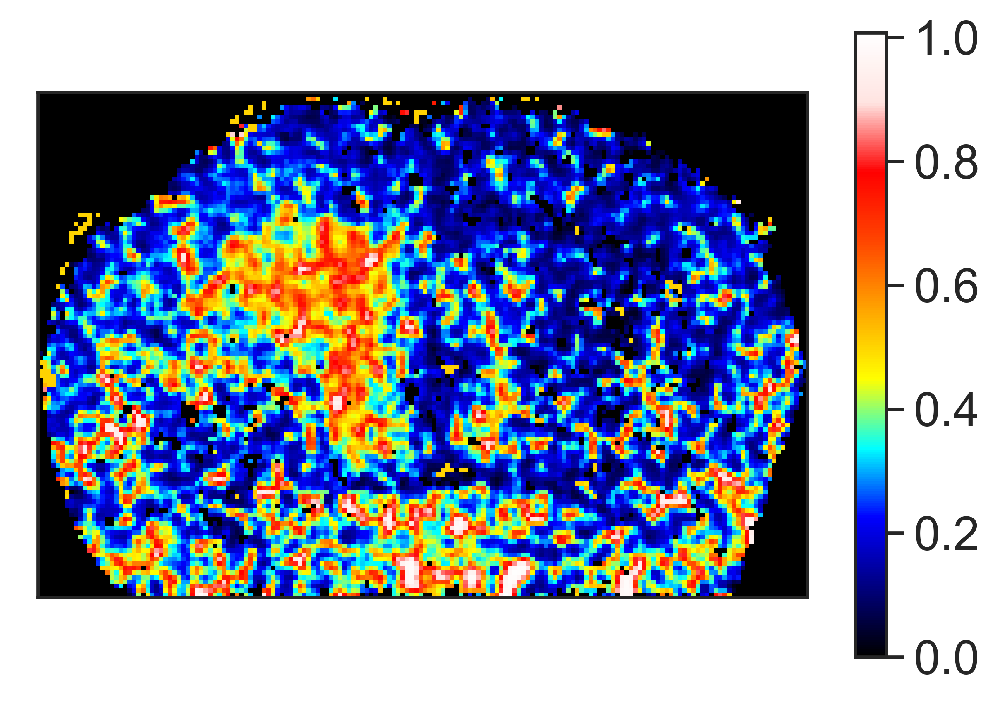

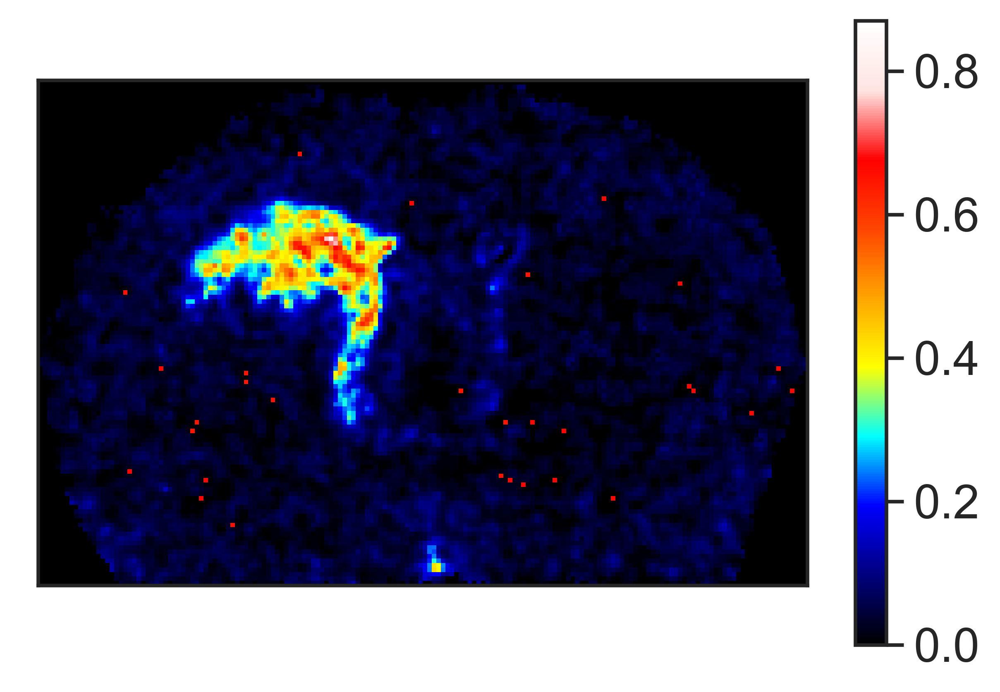

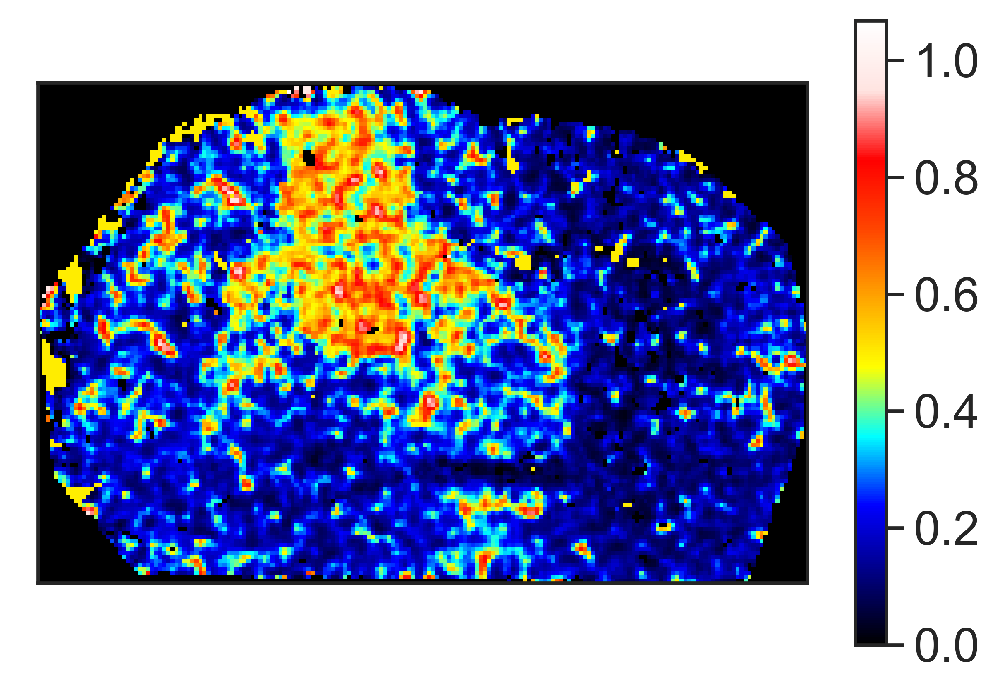

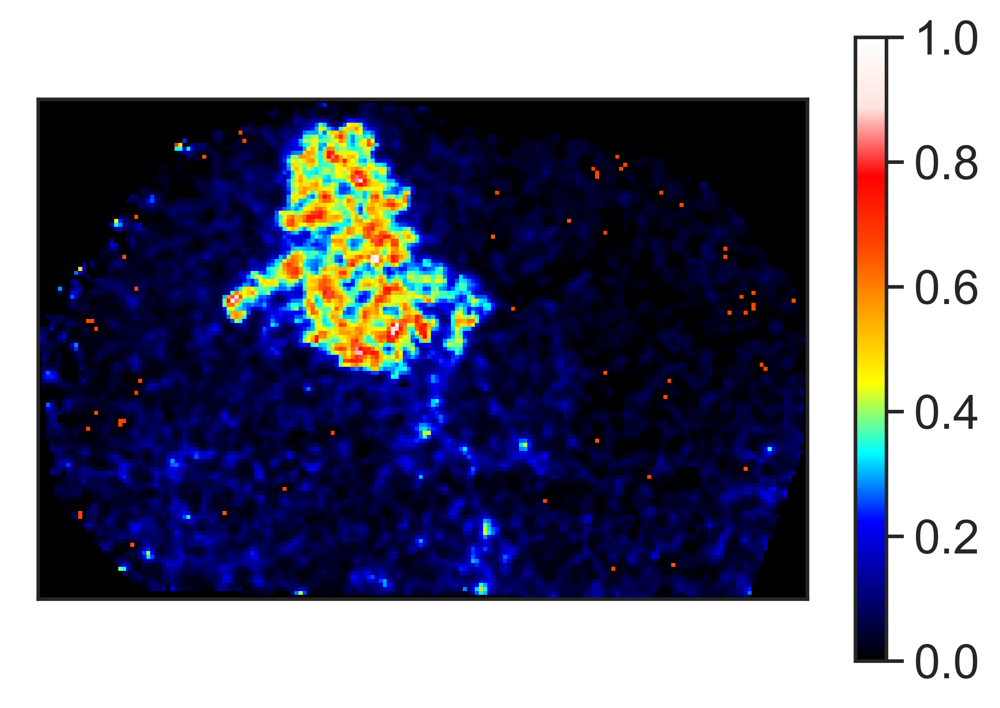

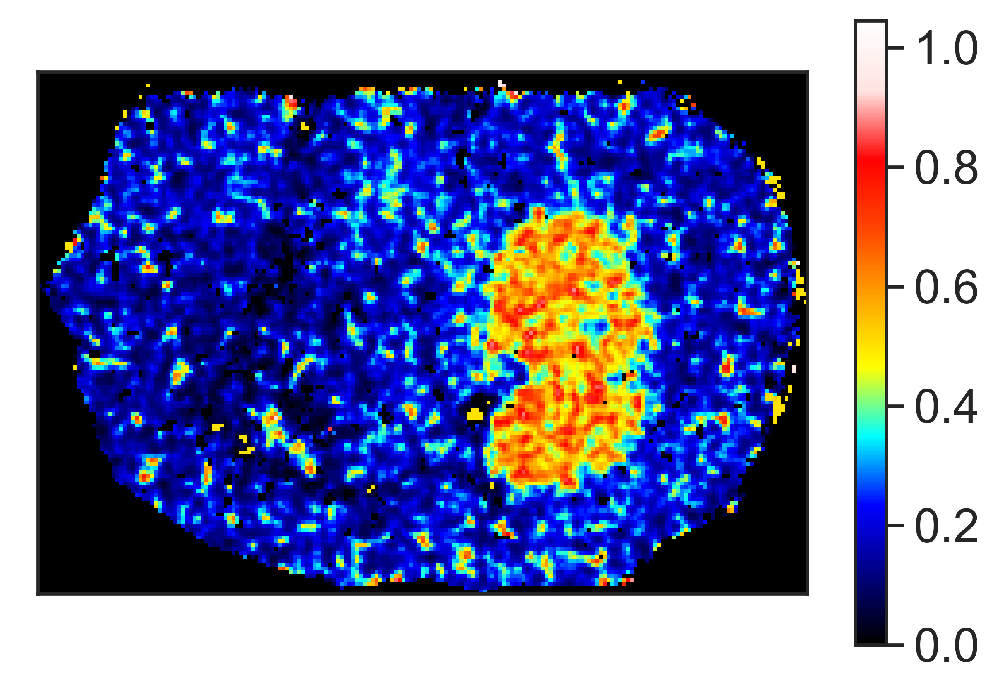

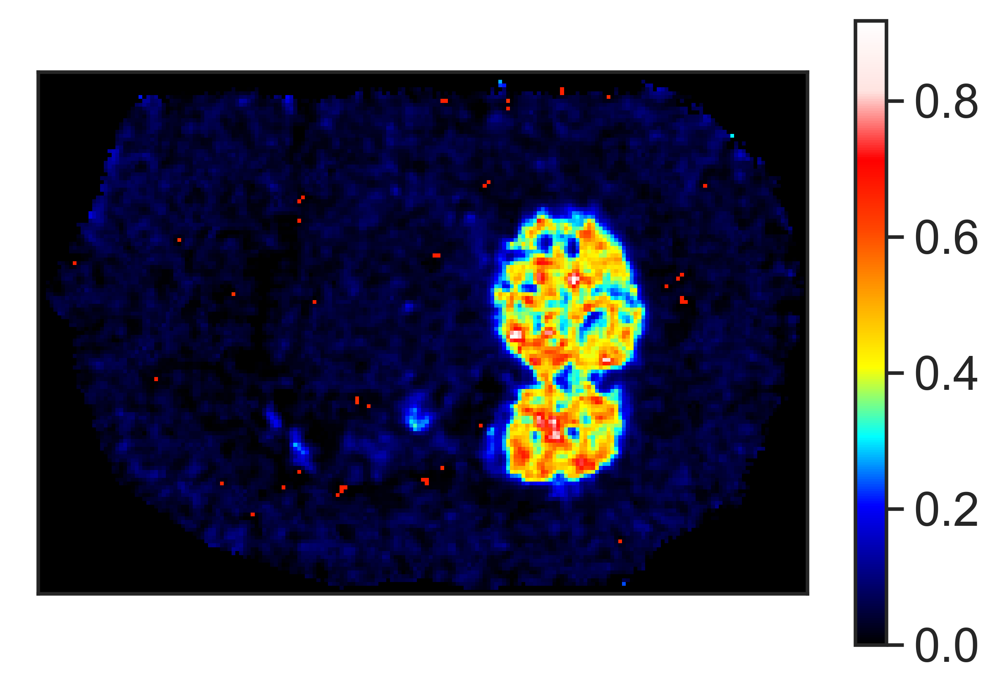

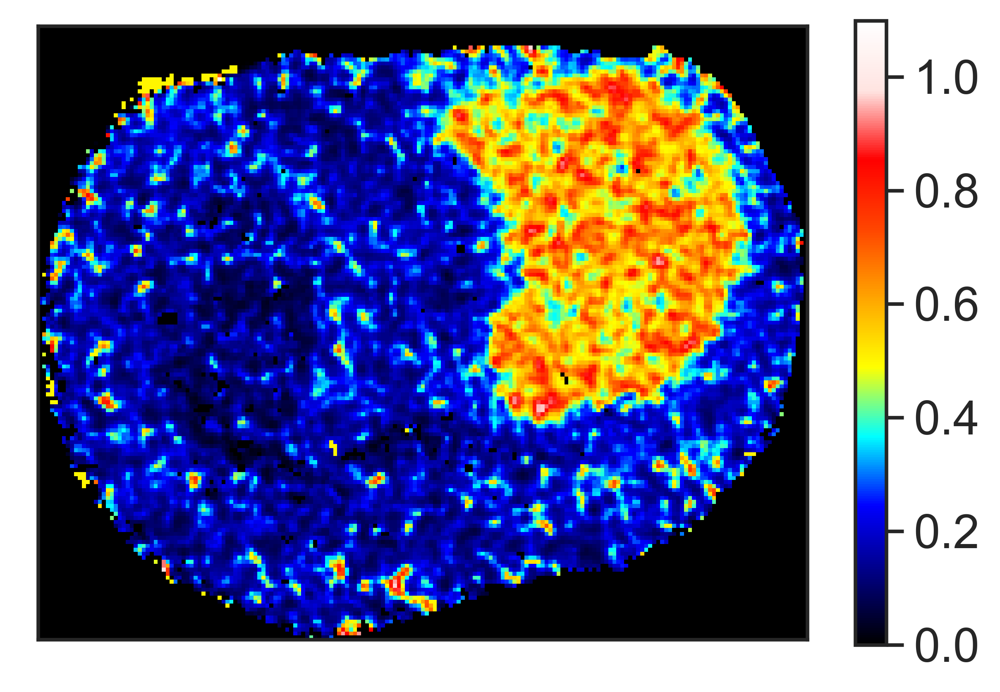

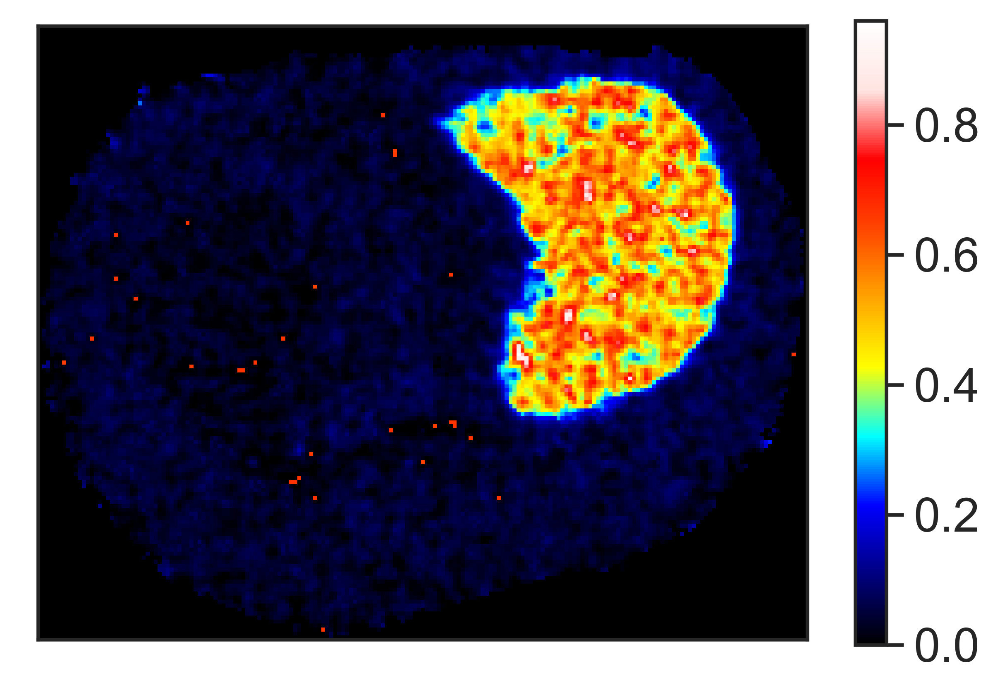

In [18]:
for subdir in subdirs:
    for fn in msis[subdir]:
        try: os.mkdir(datadir + subdir + "/" + fn.replace(".imzML",""))
        except: pass
    
badIndsPal = [1,2]
badIndsSt = [1,3]

peaklistFilt = peaklist[peaklist["formula"].isin(molsOfInterest)]
peaklistFilt = peaklistFilt.sort_values(by="mz",ascending=True)

fluxImages = {}
meanFluxes = {}

if __name__ == "__main__":
    for subdir in ["12x"]:
        for fn in msis[subdir]:
            
            box1 = boxBoundaries[subdir][fn]["i"]
            box2 = boxBoundaries[subdir][fn]["c"]
            
            fluxImages[fn] = {}
            meanFluxes[fn] = {}
            
            palmInd = peaklistFilt.index.values[0]
            stInd = peaklistFilt.index.values[1]
            
            shape = msis[subdir][fn].tic_image.shape
            
            origTensor = deepcopy(msis[subdir][fn].data_tensor)
            
            msis[subdir][fn].data_tensor[np.array(peaklistFilt.at[palmInd,"inds"])[badIndsPal]] = np.zeros((len(badIndsPal),shape[0],shape[1]))
            msis[subdir][fn].data_tensor[np.array(peaklistFilt.at[stInd,"inds"])[badIndsSt]] = np.zeros((len(badIndsSt),shape[0],shape[1]))

            fluxImageG,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[subdir][fn].runISA(inds=peaklistFilt.at[palmInd,"inds"],isaModel="flexible",minIso=0,minFrac=0.00,NACorrected=True)            
            plt.figure()
            SIMSIToolBox.showImage(fluxImageG,cmap=colormap)  
            
            meanFluxes[fn]["palmitate_g"] = np.mean(fluxImageG[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["palmitate_x0"] = np.mean(fluxImageT0[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["palmitate_x1"] = np.mean(fluxImageT1[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["palmitate_x2"] = np.mean(fluxImageT2[msis[subdir][fn].imageBoundary > 0.5])
            
            meanFluxes[fn]["palmitate_g_lh"] = getMeanValueFromBox(fluxImageG,*box1[1],*box1[0])
            meanFluxes[fn]["palmitate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
            meanFluxes[fn]["palmitate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
            meanFluxes[fn]["palmitate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])
            
            meanFluxes[fn]["palmitate_g_rh"] = getMeanValueFromBox(fluxImageG,*box2[1],*box2[0])
            meanFluxes[fn]["palmitate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
            meanFluxes[fn]["palmitate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
            meanFluxes[fn]["palmitate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])

            fluxImages[fn]["palmitate"] = {"g":fluxImageG,"e":fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

            
            fluxImageST,fluxImageE,fluxImageD,fluxImageT0,fluxImageT1,fluxImageT2,T_founds,P_trues,P_preds,numFounds,errs,errors = msis[subdir][fn].runISA(inds=peaklistFilt.at[stInd,"inds"],isaModel="elongation",minIso=0,minFrac=0.00,NACorrected=True)
            fluxImages[fn]["stearate"] = {"g":fluxImageST,"e":fluxImageE,"g+e":fluxImageST+fluxImageE,"d":fluxImageD,"x0":fluxImageT0,"x1":fluxImageT1,"x2":fluxImageT2,"errs":errs}

            plt.figure()
            SIMSIToolBox.showImage(fluxImageST + fluxImageE,cmap=colormap)
            
            meanFluxes[fn]["stearate_g"] = np.mean(fluxImageST[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["stearate_e"] = np.mean(fluxImageE[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["stearate_x0"] = np.mean(fluxImageT0[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["stearate_x1"] = np.mean(fluxImageT1[msis[subdir][fn].imageBoundary > 0.5])
            meanFluxes[fn]["stearate_x2"] = np.mean(fluxImageT2[msis[subdir][fn].imageBoundary > 0.5])
            
            meanFluxes[fn]["stearate_g_lh"] = getMeanValueFromBox(fluxImageST,*box1[1],*box1[0])
            meanFluxes[fn]["stearate_e_lf"] = getMeanValueFromBox(fluxImageE,*box1[1],*box1[0])
            meanFluxes[fn]["stearate_x0_lh"] = getMeanValueFromBox(fluxImageT0,*box1[1],*box1[0])
            meanFluxes[fn]["stearate_x1_lh"] = getMeanValueFromBox(fluxImageT1,*box1[1],*box1[0])
            meanFluxes[fn]["stearate_x2_lh"] = getMeanValueFromBox(fluxImageT2,*box1[1],*box1[0])
            
            meanFluxes[fn]["stearate_g_rh"] = getMeanValueFromBox(fluxImageST,*box2[1],*box2[0])
            meanFluxes[fn]["stearate_e_rh"] = getMeanValueFromBox(fluxImageE,*box2[1],*box2[0])
            meanFluxes[fn]["stearate_x0_rh"] = getMeanValueFromBox(fluxImageT0,*box2[1],*box2[0])
            meanFluxes[fn]["stearate_x1_rh"] = getMeanValueFromBox(fluxImageT1,*box2[1],*box2[0])
            meanFluxes[fn]["stearate_x2_rh"] = getMeanValueFromBox(fluxImageT2,*box2[1],*box2[0])
            
            msis[subdir][fn].data_tensor = origTensor
            
        meanFluxes = pd.DataFrame.from_dict(meanFluxes,orient="index")
meanFluxes

In [19]:
meanFluxes.to_csv(datadir + "average_fluxes_" + subdir + ".csv")

In [20]:
pkl.dump([peaklist,msis,fluxImages],open(datadir + "processed_data.pkl","wb"))

In [9]:
[peaklist,msis,fluxImages] = pkl.load(open(datadir + "processed_data.pkl","rb"))

In [21]:
subdir = "12x"
for fn in fluxImages:
    for mol in fluxImages[fn]:
        for val in ["g","d","e","x0","x1","x2","g+e"]:
            if val in fluxImages[fn][mol]:
                img = fluxImages[fn][mol][val]
                plt.figure()
                SIMSIToolBox.showImage(img,cmap = colormap)
                maxLim = 1.0
                plt.clim(0,maxLim)
                norm = plt.Normalize(vmin=0, vmax=maxLim)
                norm = colormap(norm(img))
                for row in range(norm.shape[0]):
                    for col in range(norm.shape[1]):
                        if msis[subdir][fn].imageBoundary[row,col] < .5:
                            norm[row,col,3] = 0
                plt.imsave(datadir + subdir + "/" + fn.replace(".imzML","/") + mol + "_" + val + ".png",norm)#,cmap=colormap)
                plt.savefig(datadir + subdir + "/" + fn.replace(".imzML","/") + mol + "_" + val + "_with_colorbar.png")
                plt.close()